In [1]:
import os
import tarfile
import numpy as np

from PIL import Image
import PIL
from matplotlib import pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision

from torch.utils.data import DataLoader
from torch.utils.data.dataset import Dataset
from torchvision.transforms import Compose, RandomCrop, ToTensor, Resize, ToPILImage, CenterCrop

In [2]:
def is_image_file(filename):
    return any(filename.endswith(extension) for extension in ['bmp', '.png', '.jpg', '.jpeg', '.PNG', '.JPG', '.JPEG'])

class DatasetFromfolder(Dataset):
    def __init__(self, path):
        super(DatasetFromfolder, self).__init__()
        self.filenames = []
        folders = os.listdir(path)
        for f in folders:
            self.filenames.append(path + f)
        self.data_transform = Compose([CenterCrop(25), ToTensor()])
        self.data_transform_PIL = Compose([ToPILImage()])

    def __getitem__(self, index):        
        w = h = 512
        img = Image.open(self.filenames[index])
        img, _cb, _cr = img.convert('YCbCr').split()     
        img = self.data_transform(img)           
        result_image = img
        
        resize_image = self.data_transform_PIL(img)        
        resize_image = resize_image.resize((int(w/2), int(h/2)))
        resize_image = resize_image.resize((w, h), Image.BICUBIC)
        resize_image = self.data_transform(resize_image) 
        
        return result_image, resize_image

    def __len__(self):
        return len(self.filenames)

In [3]:
root_dir = '../input/bhp-images/BHPIDC20/'

In [4]:
test_path_normal = os.path.join(root_dir, "test/0")

test_img_normal_paths = sorted(
    [
        os.path.join(test_path_normal, fname)
        for fname in os.listdir(test_path_normal)
        if fname.endswith(".png")
    ]
)

In [5]:
test_path_pneumonia = os.path.join(root_dir, "test/1")

test_img_pneumonia_paths = sorted(
    [
        os.path.join(test_path_pneumonia, fname)
        for fname in os.listdir(test_path_pneumonia)
        if fname.endswith(".png")
    ]
)

In [6]:
class SuperResolutionCNN(nn.Module):
    def __init__(self):
        super(SuperResolutionCNN, self).__init__()
        self.Conv1 = nn.Conv2d(1, 64, 9, 1, 4)
        self.Conv2 = nn.Conv2d(64, 32, 3, 1, 1)
        self.Conv3 = nn.Conv2d(32, 1, 5, 1, 2)
        self.Relu = nn.ReLU()
        self.sig = nn.Sigmoid()

    def forward(self, x):
        out = self.Relu(self.Conv1(x))
        out = self.Relu(self.Conv2(out))
        out = self.Conv3(out)
        return out

In [7]:
data_transform = Compose([ToTensor()])    
    
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train_set = DatasetFromfolder('../input/bhp-images/BHPIDC20/train/')
train_loader = DataLoader(dataset=train_set, num_workers=0, batch_size=64, shuffle=True)

SRCNN = SuperResolutionCNN()
if torch.cuda.device_count() > 1:
    SRCNN = nn.DataParallel(SRCNN)
SRCNN.to(device)    

optimizer = optim.Adam(SRCNN.parameters())
criterion = nn.MSELoss().to(device)

#new_point = 0
os.system('mkdir /tmp/checkpoint')
os.system('mkdir /tmp/image')

256

In [12]:
def train(NUM_EPOCHS=1):
    #NUM_EPOCHS = 10 #501
#     data_transform = Compose([ToTensor()])    
    
#     device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#     train_set = DatasetFromfolder('../input/xray-normal/xray_dataset_normal/train/')
#     train_loader = DataLoader(dataset=train_set, num_workers=0, batch_size=64, shuffle=True)
    
#     SRCNN = SuperResolutionCNN()
#     if torch.cuda.device_count() > 1:
#         SRCNN = nn.DataParallel(SRCNN)
#     SRCNN.to(device)    
    
#     optimizer = optim.Adam(SRCNN.parameters())
#     criterion = nn.MSELoss().to(device)
    
    new_point = 0
#     os.system('mkdir checkpoint')
#     os.system('mkdir image')
    
    for epoch in range(NUM_EPOCHS+1):        
        batch_idx = 0        
        for HR, LR in train_loader:
            HR = HR.to(device)
            LR = LR.to(device)            
            newHR = SRCNN(LR) 
            
            SRCNN.train()
            SRCNN.zero_grad()
            loss = criterion(HR, newHR)
            loss.backward(retain_graph=True)
            optimizer.step()
            
            if epoch%100==0 and batch_idx%1==0:
                SRCNN.eval()
                print("Epoch:{} batch[{}/{}] loss:{}".format(epoch, batch_idx, len(train_loader), loss))      
                
                img = Image.open('../input/bhp-images/BHPIDC20/valid/8950_idx5_x2001_y1301_class0.png')   
                            
                w, h = img.size
                
                result_image = img
                result_image_y, _cb, _cr = result_image.convert('YCbCr').split()
                result_image_y = data_transform(result_image_y)   
                
        
                resize_image = img.resize((int(w/2), int(h/2)), Image.BICUBIC)       
                resize_image = resize_image.resize((w, h), Image.BICUBIC)
                resize_image_y, _cb1, _cr1 = resize_image.convert('YCbCr').split()
                resize_image_y = data_transform(resize_image_y).to(device)
                newHR = SRCNN(resize_image_y.unsqueeze(0))
                #print(newHR[0].shape)
                out_img_y = newHR[0]
                out_img_y *= 255.0
                out_img_y = out_img_y.cpu().data.numpy()
                # Restore the image in RGB color space.
                out_img_y = out_img_y.clip(0, 255)
                out_img_y = out_img_y.reshape((np.shape(out_img_y)[1], np.shape(out_img_y)[2]))
                out_img_y = PIL.Image.fromarray(np.uint8(out_img_y), mode="L")
                out_img_cb = _cb1.resize(out_img_y.size, PIL.Image.BICUBIC)
                out_img_cr = _cr1.resize(out_img_y.size, PIL.Image.BICUBIC)
                out_img = PIL.Image.merge("YCbCr", (out_img_y, out_img_cb, out_img_cr)).convert("RGB")
                
                resize_image.save(f'/tmp/image/LR{epoch}.png')
                result_image.save(f'/tmp/image/HR{epoch}.png')
                out_img.save(f'/tmp/image/newHR{epoch}.png')
                
                im1 = Image.open(f'/tmp/image/LR{epoch}.png')
                im2 = Image.open(f'/tmp/image/HR{epoch}.png')
                im3 = Image.open(f'/tmp/image/newHR{epoch}.png')                
                dst = Image.new('RGB', (w*3 , h))
                dst.paste(im1, (0, 0))
                dst.paste(im2, (w, 0))
                dst.paste(im3, (w*2, 0))
                dst.save(f'/tmp/image/image{epoch}.png')
                img = Image.open(f'/tmp/image/image{epoch}.png')
                plt.imshow(img)
                plt.title(f'Image After {epoch} epochs')
                plt.show()
                
            batch_idx += 1
            
        torch.save(SRCNN.state_dict(), '/tmp/checkpoint/ckpt_%d.pth' % (new_point))
        new_point += 1

Epoch:0 batch[0/125] loss:0.02532503567636013


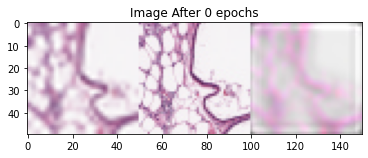

Epoch:0 batch[1/125] loss:0.02553919330239296


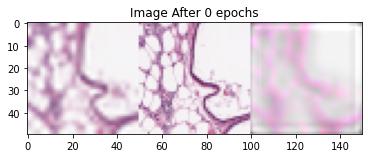

Epoch:0 batch[2/125] loss:0.02671872451901436


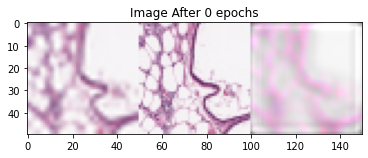

Epoch:0 batch[3/125] loss:0.024182381108403206


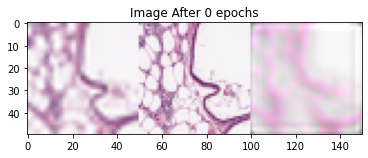

Epoch:0 batch[4/125] loss:0.02678818255662918


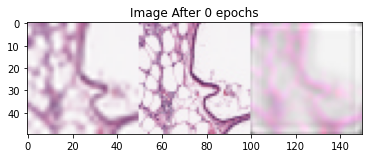

Epoch:0 batch[5/125] loss:0.02201814204454422


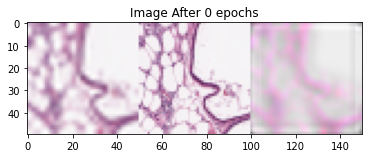

Epoch:0 batch[6/125] loss:0.025754060596227646


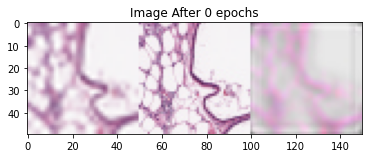

Epoch:0 batch[7/125] loss:0.024864336475729942


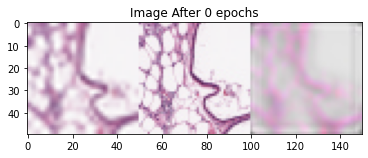

Epoch:0 batch[8/125] loss:0.02318469248712063


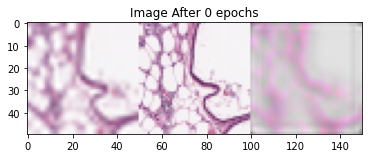

Epoch:0 batch[9/125] loss:0.02397419698536396


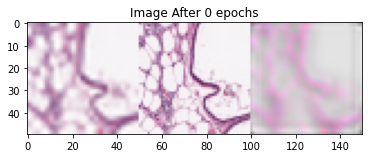

Epoch:0 batch[10/125] loss:0.018017997965216637


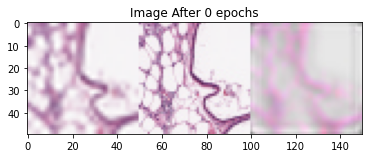

Epoch:0 batch[11/125] loss:0.020485829561948776


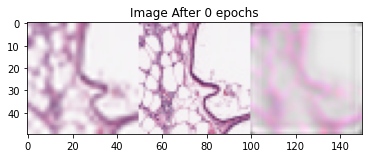

Epoch:0 batch[12/125] loss:0.0247176606208086


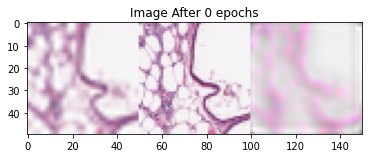

Epoch:0 batch[13/125] loss:0.02644185721874237


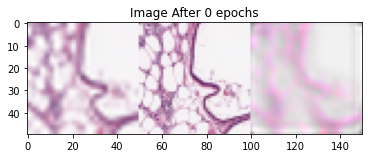

Epoch:0 batch[14/125] loss:0.02833455055952072


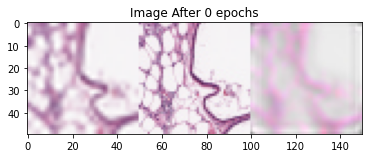

Epoch:0 batch[15/125] loss:0.022963128983974457


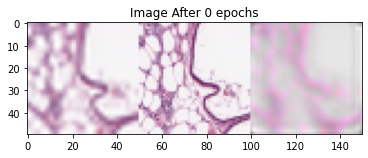

Epoch:0 batch[16/125] loss:0.021390629932284355


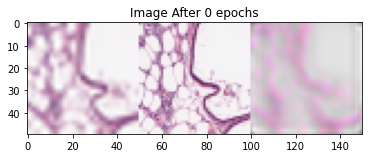

Epoch:0 batch[17/125] loss:0.02063203975558281


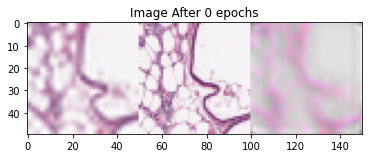

Epoch:0 batch[18/125] loss:0.02422107197344303


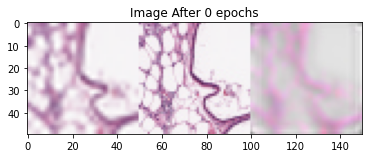

Epoch:0 batch[19/125] loss:0.022253137081861496


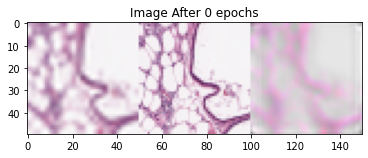

Epoch:0 batch[20/125] loss:0.01905476674437523


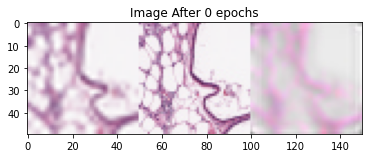

Epoch:0 batch[21/125] loss:0.01959824748337269


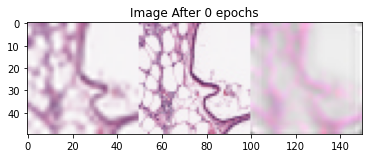

Epoch:0 batch[22/125] loss:0.022423194721341133


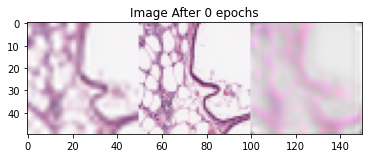

Epoch:0 batch[23/125] loss:0.018922511488199234


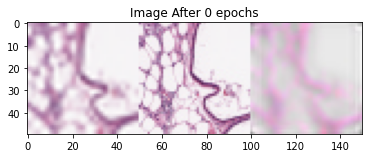

Epoch:0 batch[24/125] loss:0.03088531084358692


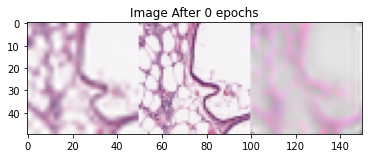

Epoch:0 batch[25/125] loss:0.018397348001599312


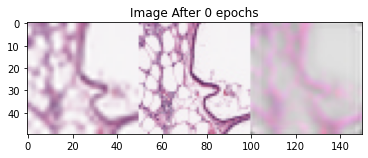

Epoch:0 batch[26/125] loss:0.02006661705672741


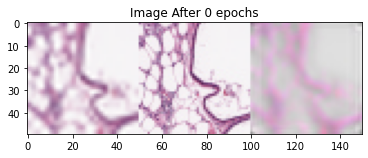

Epoch:0 batch[27/125] loss:0.01776721142232418


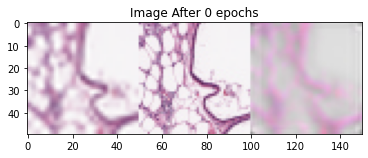

Epoch:0 batch[28/125] loss:0.023913128301501274


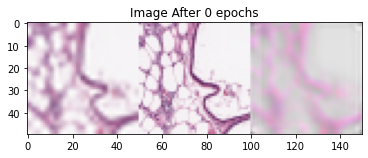

Epoch:0 batch[29/125] loss:0.019934775307774544


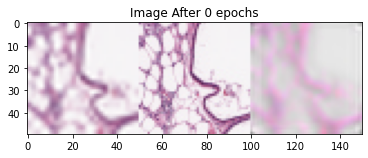

Epoch:0 batch[30/125] loss:0.020116666331887245


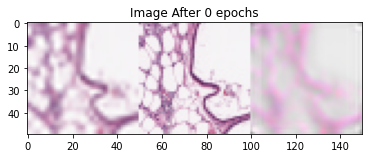

Epoch:0 batch[31/125] loss:0.024492226541042328


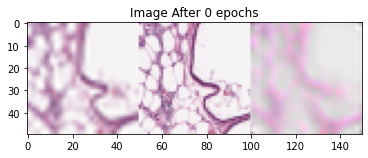

Epoch:0 batch[32/125] loss:0.02335677668452263


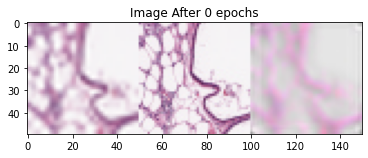

Epoch:0 batch[33/125] loss:0.02363058179616928


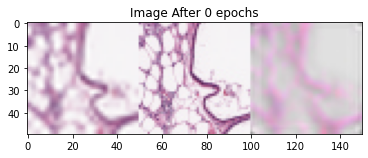

Epoch:0 batch[34/125] loss:0.02216840535402298


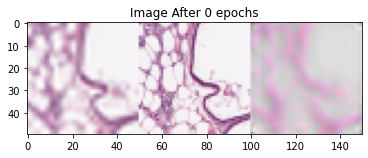

Epoch:0 batch[35/125] loss:0.021564725786447525


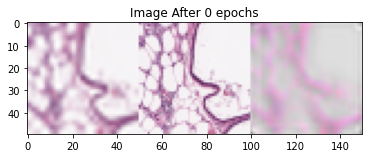

Epoch:0 batch[36/125] loss:0.02485254593193531


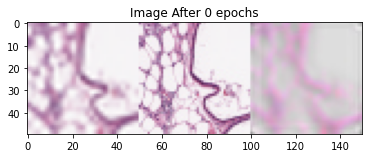

Epoch:0 batch[37/125] loss:0.020511465147137642


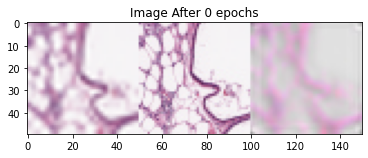

Epoch:0 batch[38/125] loss:0.020022865384817123


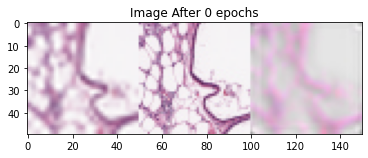

Epoch:0 batch[39/125] loss:0.02075347863137722


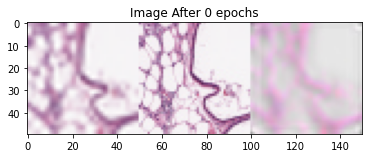

Epoch:0 batch[40/125] loss:0.01888434775173664


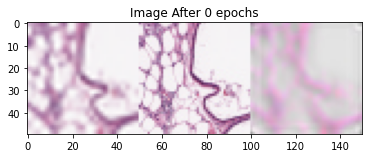

Epoch:0 batch[41/125] loss:0.018286854028701782


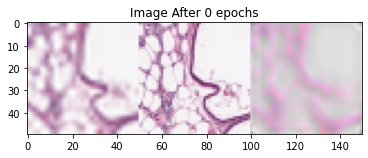

Epoch:0 batch[42/125] loss:0.02286563627421856


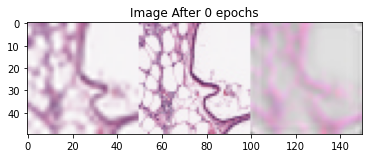

Epoch:0 batch[43/125] loss:0.021567046642303467


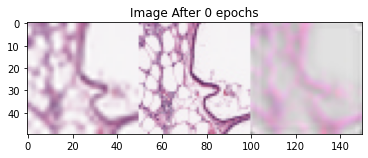

Epoch:0 batch[44/125] loss:0.02210088260471821


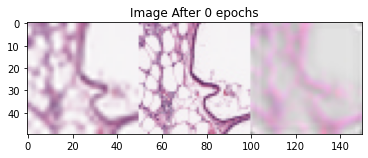

Epoch:0 batch[45/125] loss:0.02789667807519436


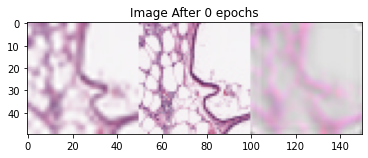

Epoch:0 batch[46/125] loss:0.020100057125091553


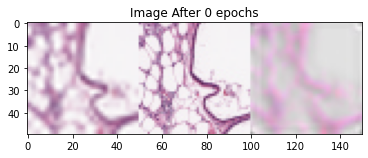

Epoch:0 batch[47/125] loss:0.01895161345601082


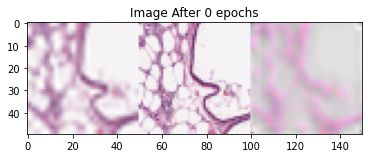

Epoch:0 batch[48/125] loss:0.02425936609506607


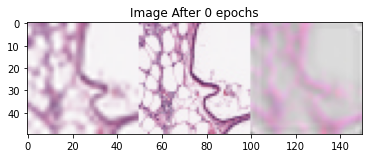

Epoch:0 batch[49/125] loss:0.01511650625616312


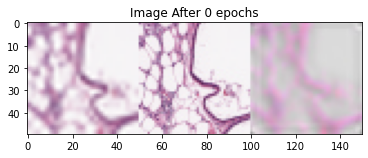

Epoch:0 batch[50/125] loss:0.018063245341181755


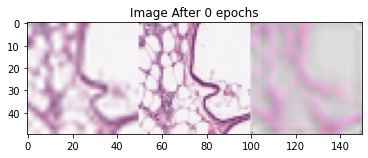

Epoch:0 batch[51/125] loss:0.020307473838329315


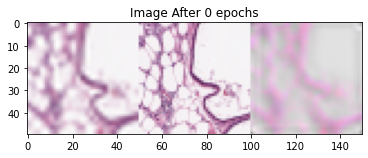

Epoch:0 batch[52/125] loss:0.024403560906648636


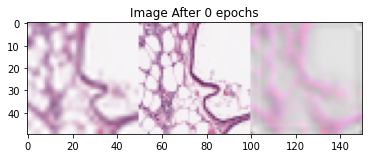

Epoch:0 batch[53/125] loss:0.02087371051311493


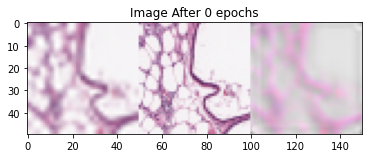

Epoch:0 batch[54/125] loss:0.021527055650949478


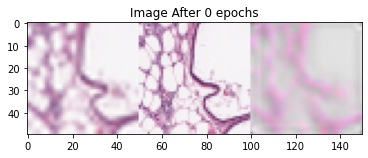

Epoch:0 batch[55/125] loss:0.021920418366789818


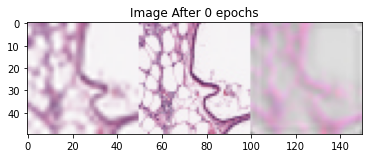

Epoch:0 batch[56/125] loss:0.01822306402027607


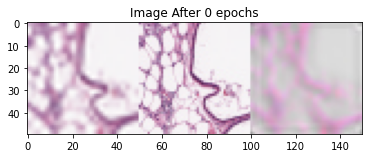

Epoch:0 batch[57/125] loss:0.02174060046672821


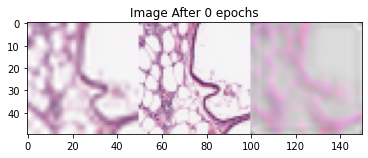

Epoch:0 batch[58/125] loss:0.023783763870596886


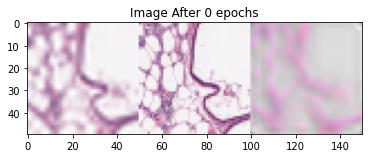

Epoch:0 batch[59/125] loss:0.027352647855877876


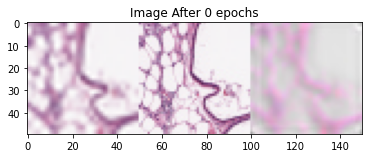

Epoch:0 batch[60/125] loss:0.02570292539894581


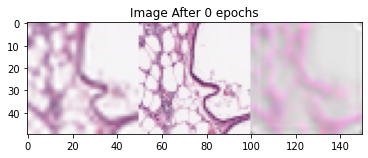

Epoch:0 batch[61/125] loss:0.020127534866333008


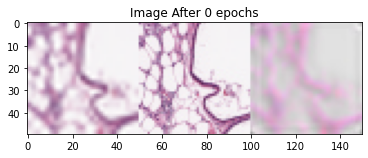

Epoch:0 batch[62/125] loss:0.01816948503255844


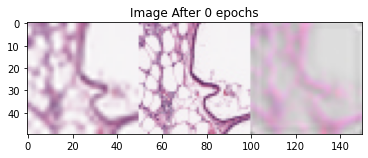

Epoch:0 batch[63/125] loss:0.02470238506793976


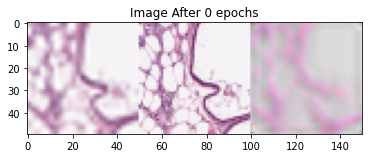

Epoch:0 batch[64/125] loss:0.022106654942035675


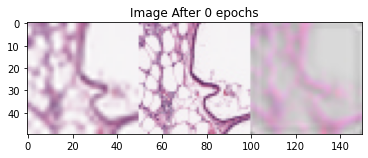

Epoch:0 batch[65/125] loss:0.02106691710650921


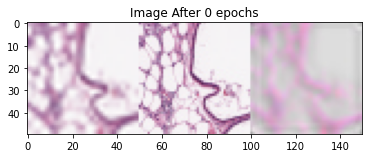

Epoch:0 batch[66/125] loss:0.02018376998603344


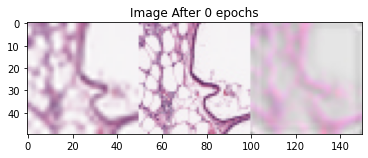

Epoch:0 batch[67/125] loss:0.020596928894519806


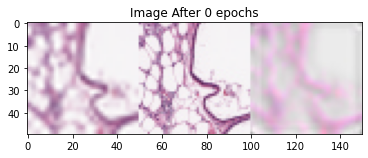

Epoch:0 batch[68/125] loss:0.023334292694926262


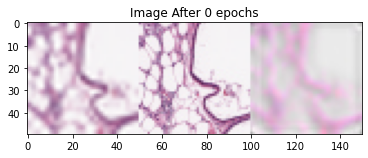

Epoch:0 batch[69/125] loss:0.017707528546452522


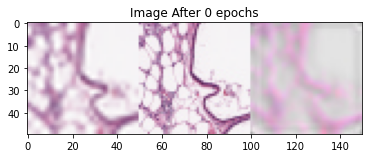

Epoch:0 batch[70/125] loss:0.017355483025312424


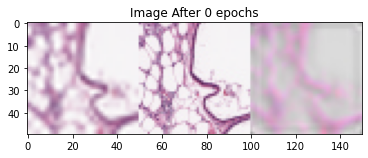

Epoch:0 batch[71/125] loss:0.02284812182188034


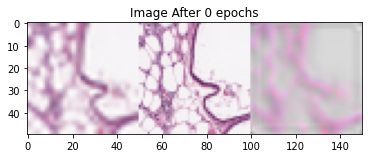

Epoch:0 batch[72/125] loss:0.021043160930275917


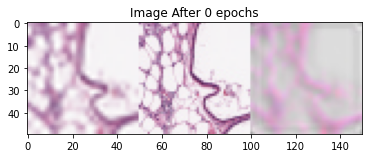

Epoch:0 batch[73/125] loss:0.023182827979326248


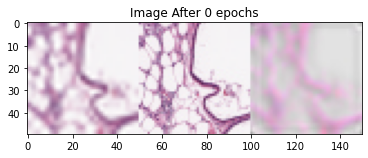

Epoch:0 batch[74/125] loss:0.021595237776637077


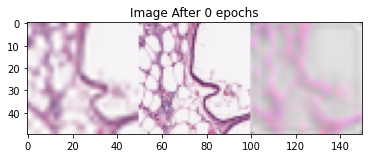

Epoch:0 batch[75/125] loss:0.02524522878229618


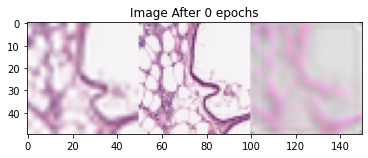

Epoch:0 batch[76/125] loss:0.017130602151155472


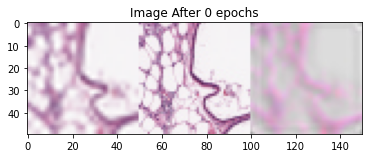

Epoch:0 batch[77/125] loss:0.023517971858382225


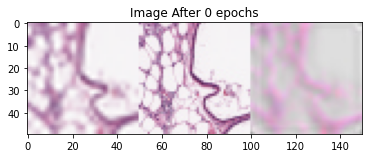

Epoch:0 batch[78/125] loss:0.024569179862737656


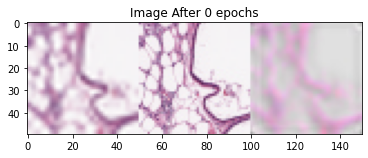

Epoch:0 batch[79/125] loss:0.022676890715956688


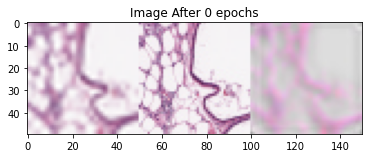

Epoch:0 batch[80/125] loss:0.02276690863072872


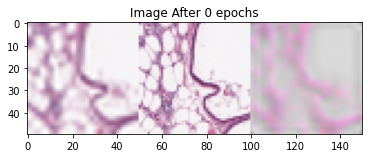

Epoch:0 batch[81/125] loss:0.020490985363721848


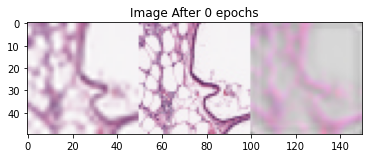

Epoch:0 batch[82/125] loss:0.022315295413136482


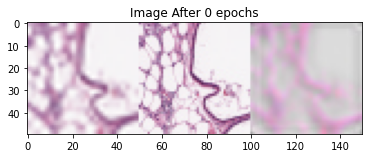

Epoch:0 batch[83/125] loss:0.02208312600851059


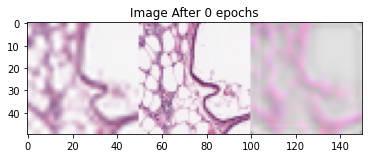

Epoch:0 batch[84/125] loss:0.023029733449220657


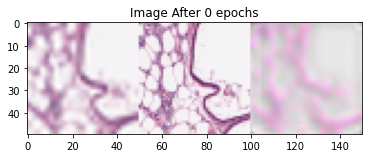

Epoch:0 batch[85/125] loss:0.023687344044446945


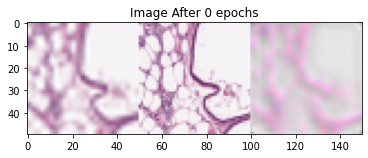

Epoch:0 batch[86/125] loss:0.023286616429686546


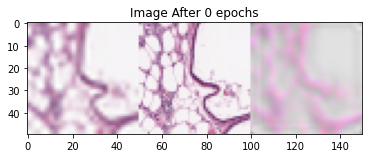

Epoch:0 batch[87/125] loss:0.02672896347939968


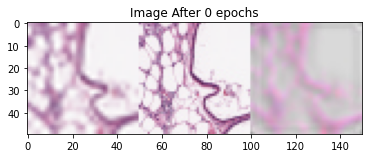

Epoch:0 batch[88/125] loss:0.01874442584812641


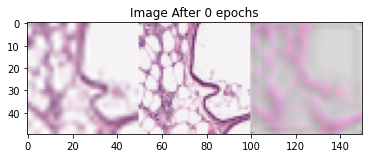

Epoch:0 batch[89/125] loss:0.024863744154572487


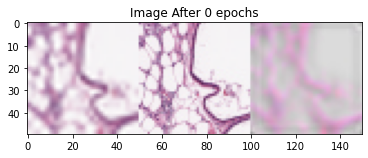

Epoch:0 batch[90/125] loss:0.022813253104686737


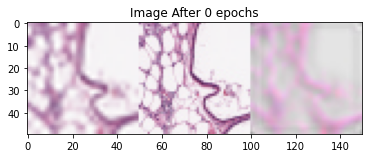

Epoch:0 batch[91/125] loss:0.02119271084666252


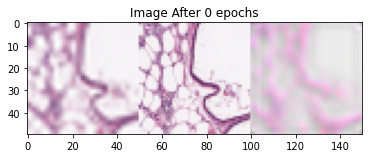

Epoch:0 batch[92/125] loss:0.024088894948363304


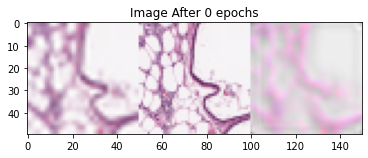

Epoch:0 batch[93/125] loss:0.023303156718611717


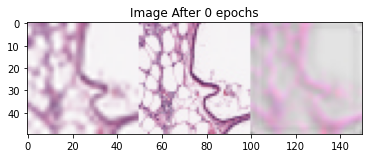

Epoch:0 batch[94/125] loss:0.021072447299957275


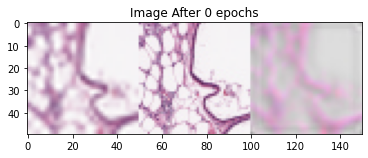

Epoch:0 batch[95/125] loss:0.019987937062978745


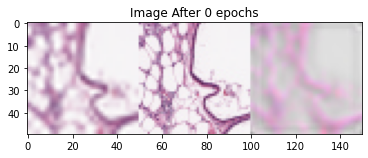

Epoch:0 batch[96/125] loss:0.01703052595257759


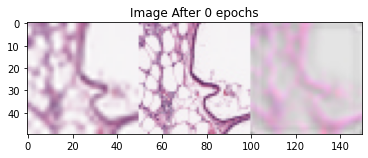

Epoch:0 batch[97/125] loss:0.025048043578863144


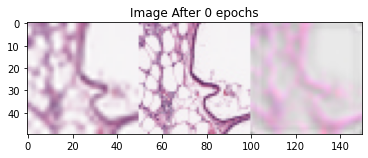

Epoch:0 batch[98/125] loss:0.024272777140140533


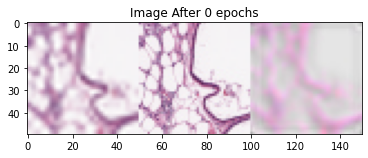

Epoch:0 batch[99/125] loss:0.020528869703412056


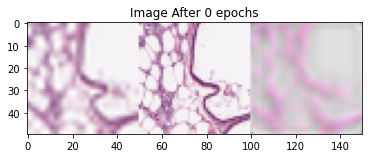

Epoch:0 batch[100/125] loss:0.019544143229722977


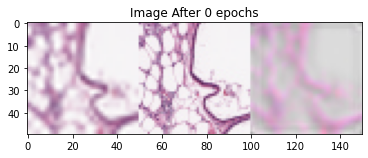

Epoch:0 batch[101/125] loss:0.027244526892900467


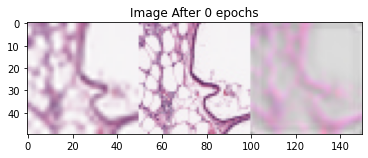

Epoch:0 batch[102/125] loss:0.021072521805763245


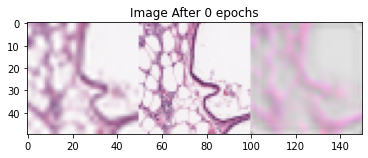

Epoch:0 batch[103/125] loss:0.019166503101587296


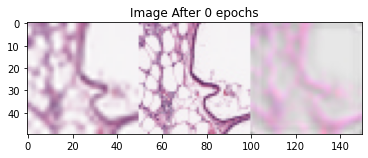

Epoch:0 batch[104/125] loss:0.020569460466504097


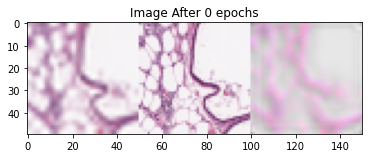

Epoch:0 batch[105/125] loss:0.02105780504643917


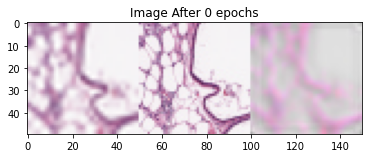

Epoch:0 batch[106/125] loss:0.02303445152938366


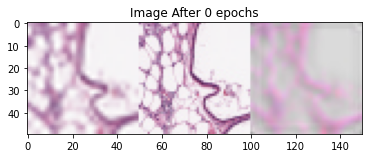

Epoch:0 batch[107/125] loss:0.0240680743008852


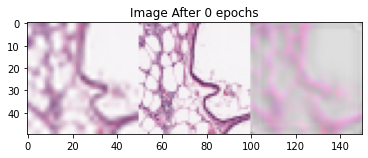

Epoch:0 batch[108/125] loss:0.02131936512887478


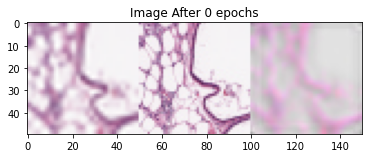

Epoch:0 batch[109/125] loss:0.022438015788793564


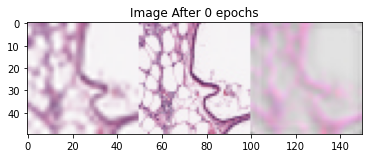

Epoch:0 batch[110/125] loss:0.02211027219891548


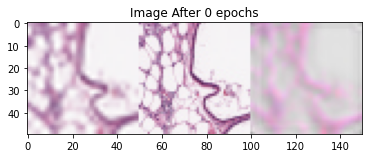

Epoch:0 batch[111/125] loss:0.023608015850186348


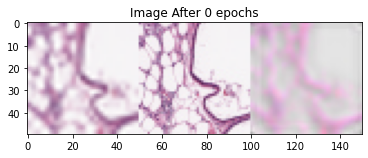

Epoch:0 batch[112/125] loss:0.021806539967656136


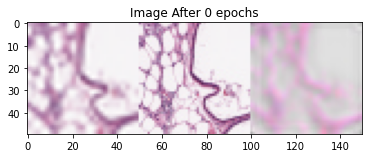

Epoch:0 batch[113/125] loss:0.022685516625642776


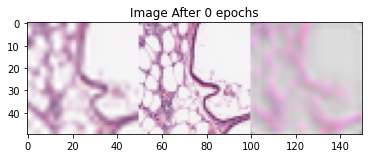

Epoch:0 batch[114/125] loss:0.02089436911046505


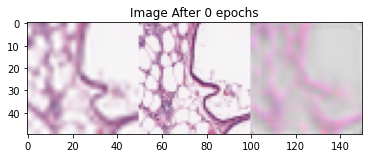

Epoch:0 batch[115/125] loss:0.018534453585743904


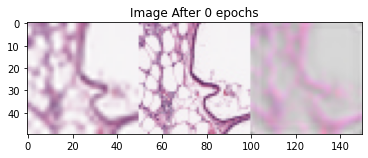

Epoch:0 batch[116/125] loss:0.021802356466650963


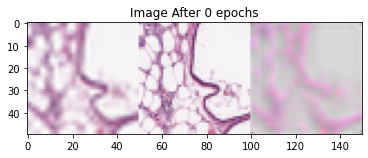

Epoch:0 batch[117/125] loss:0.02092478610575199


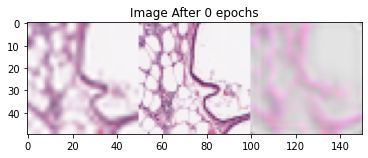

Epoch:0 batch[118/125] loss:0.021974969655275345


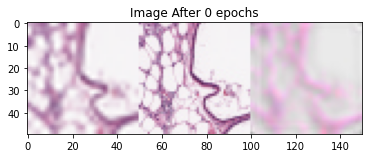

Epoch:0 batch[119/125] loss:0.022760754451155663


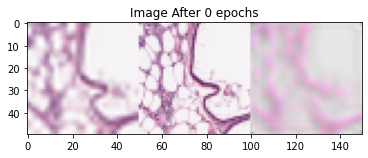

Epoch:0 batch[120/125] loss:0.02673133835196495


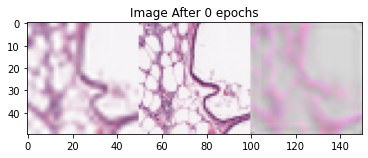

Epoch:0 batch[121/125] loss:0.020039403811097145


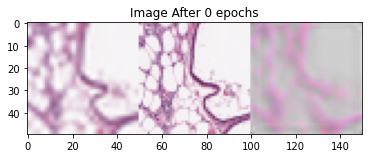

Epoch:0 batch[122/125] loss:0.023275088518857956


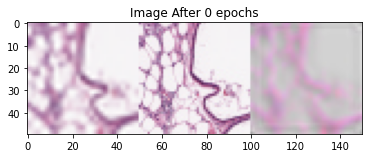

Epoch:0 batch[123/125] loss:0.023678695783019066


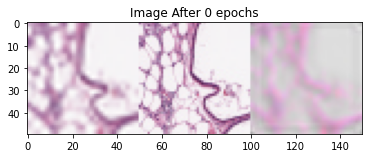

Epoch:0 batch[124/125] loss:0.02166564203798771


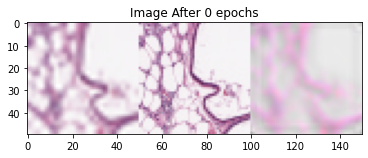

Epoch:100 batch[0/125] loss:0.021245351061224937


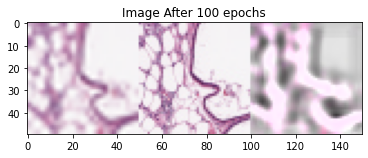

Epoch:100 batch[1/125] loss:0.021406792104244232


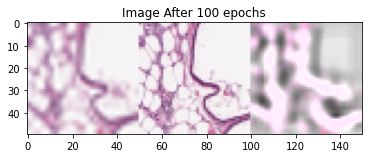

Epoch:100 batch[2/125] loss:0.019351426512002945


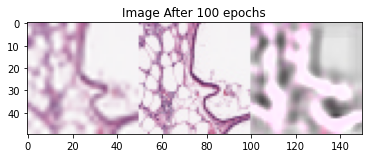

Epoch:100 batch[3/125] loss:0.016938375309109688


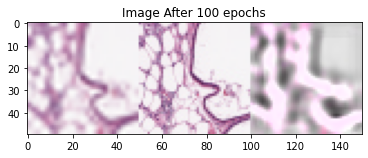

Epoch:100 batch[4/125] loss:0.020797906443476677


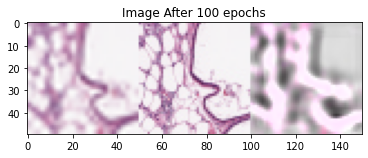

Epoch:100 batch[5/125] loss:0.01809290051460266


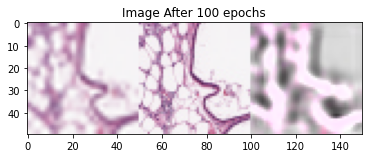

Epoch:100 batch[6/125] loss:0.021454567089676857


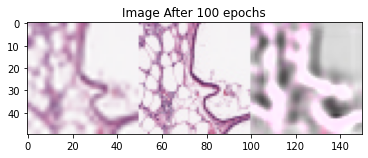

Epoch:100 batch[7/125] loss:0.022940389811992645


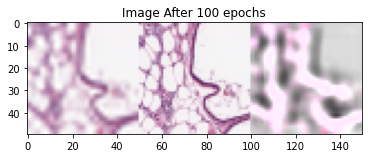

Epoch:100 batch[8/125] loss:0.02215147390961647


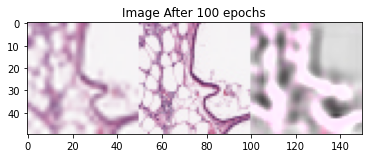

Epoch:100 batch[9/125] loss:0.019721098244190216


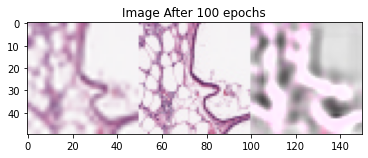

Epoch:100 batch[10/125] loss:0.02118443325161934


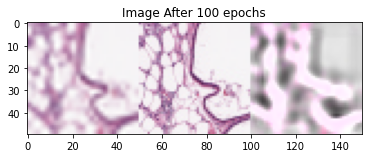

Epoch:100 batch[11/125] loss:0.021921010687947273


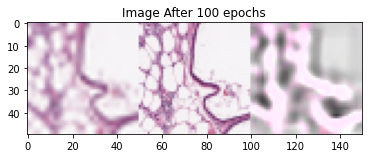

Epoch:100 batch[12/125] loss:0.015393530018627644


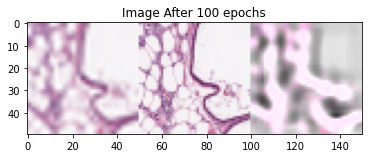

Epoch:100 batch[13/125] loss:0.020989617332816124


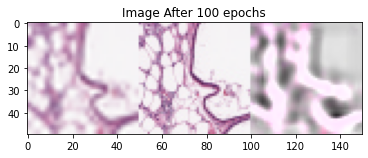

Epoch:100 batch[14/125] loss:0.01868498884141445


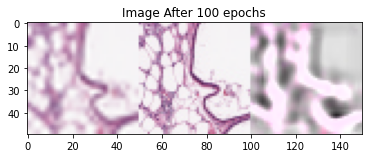

Epoch:100 batch[15/125] loss:0.01632097363471985


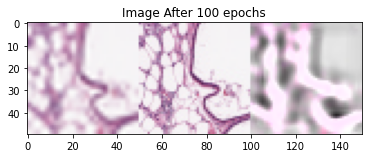

Epoch:100 batch[16/125] loss:0.021186463534832


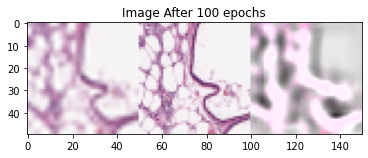

Epoch:100 batch[17/125] loss:0.0207081101834774


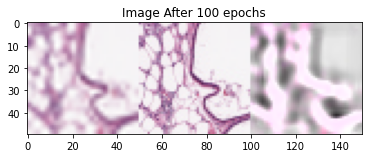

Epoch:100 batch[18/125] loss:0.020013533532619476


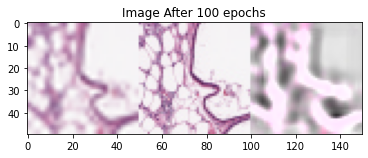

Epoch:100 batch[19/125] loss:0.02109679765999317


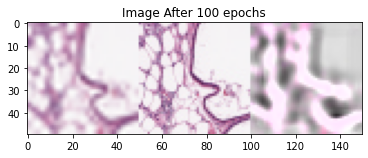

Epoch:100 batch[20/125] loss:0.020175710320472717


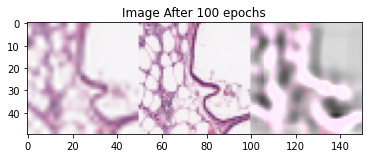

Epoch:100 batch[21/125] loss:0.01728200726211071


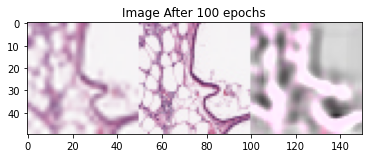

Epoch:100 batch[22/125] loss:0.02001224085688591


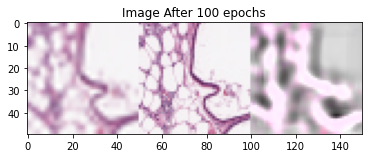

Epoch:100 batch[23/125] loss:0.02078438736498356


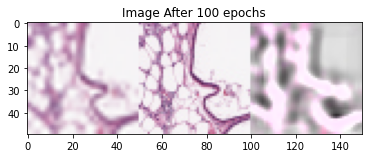

Epoch:100 batch[24/125] loss:0.020328711718320847


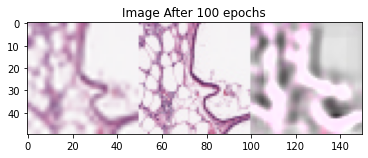

Epoch:100 batch[25/125] loss:0.02160198614001274


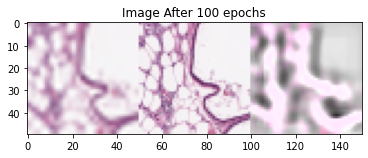

Epoch:100 batch[26/125] loss:0.020506517961621284


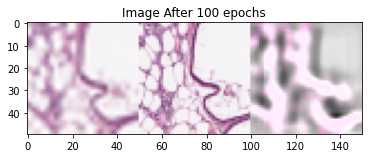

Epoch:100 batch[27/125] loss:0.017119234427809715


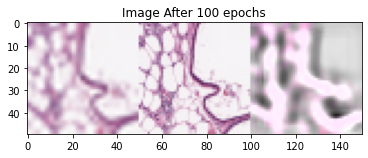

Epoch:100 batch[28/125] loss:0.01894988678395748


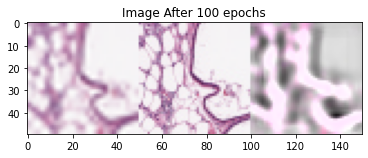

Epoch:100 batch[29/125] loss:0.015478306449949741


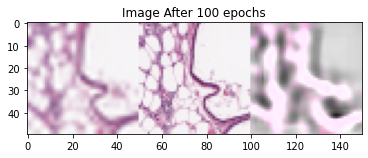

Epoch:100 batch[30/125] loss:0.021423520520329475


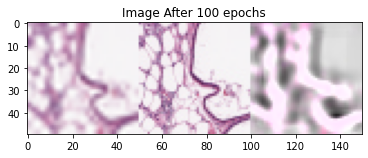

Epoch:100 batch[31/125] loss:0.02386532910168171


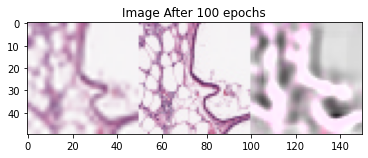

Epoch:100 batch[32/125] loss:0.024277206510305405


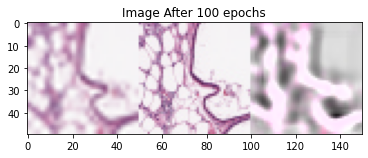

Epoch:100 batch[33/125] loss:0.017921486869454384


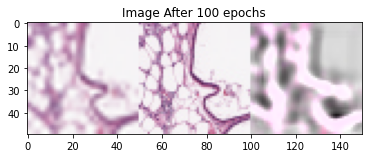

Epoch:100 batch[34/125] loss:0.02015751600265503


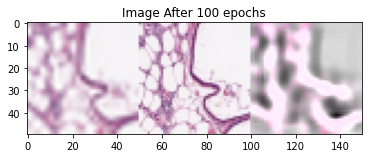

Epoch:100 batch[35/125] loss:0.019078437238931656


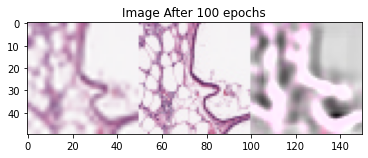

Epoch:100 batch[36/125] loss:0.022750679403543472


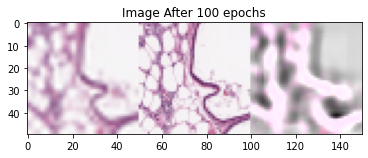

Epoch:100 batch[37/125] loss:0.023473672568798065


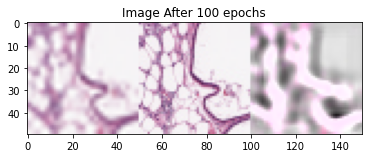

Epoch:100 batch[38/125] loss:0.021336304023861885


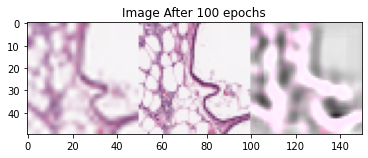

Epoch:100 batch[39/125] loss:0.019659312441945076


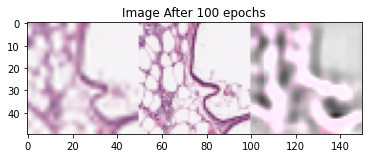

Epoch:100 batch[40/125] loss:0.01711125485599041


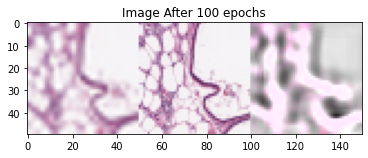

Epoch:100 batch[41/125] loss:0.020172612741589546


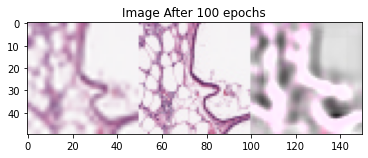

Epoch:100 batch[42/125] loss:0.017900362610816956


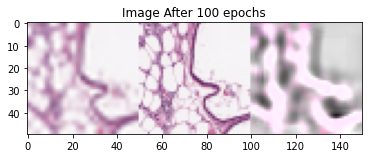

Epoch:100 batch[43/125] loss:0.018532535061240196


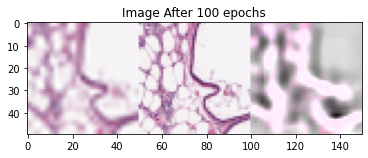

Epoch:100 batch[44/125] loss:0.020253075286746025


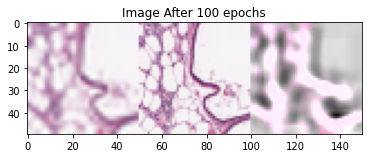

Epoch:100 batch[45/125] loss:0.020444674417376518


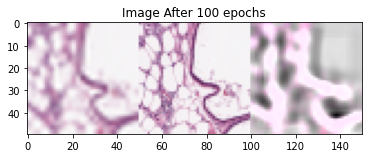

Epoch:100 batch[46/125] loss:0.01612403616309166


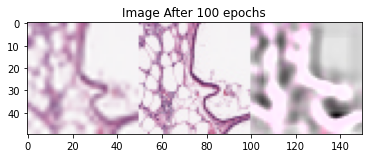

Epoch:100 batch[47/125] loss:0.020714953541755676


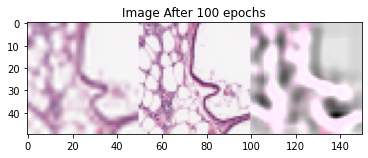

Epoch:100 batch[48/125] loss:0.020986702293157578


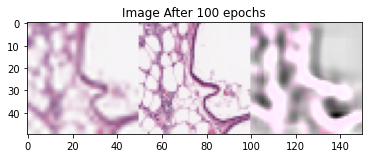

Epoch:100 batch[49/125] loss:0.020365402102470398


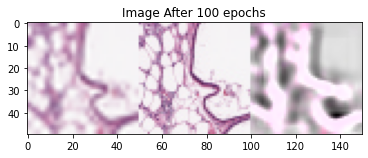

Epoch:100 batch[50/125] loss:0.021107878535985947


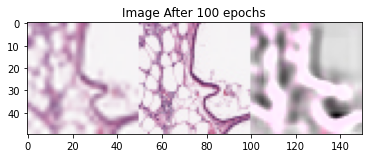

Epoch:100 batch[51/125] loss:0.019841758534312248


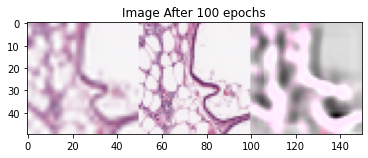

Epoch:100 batch[52/125] loss:0.016450922936201096


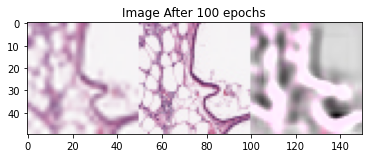

Epoch:100 batch[53/125] loss:0.02198864333331585


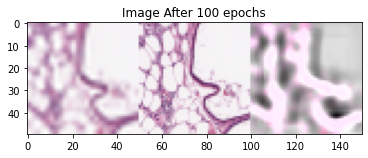

Epoch:100 batch[54/125] loss:0.01743840053677559


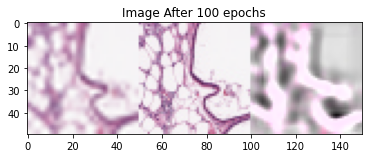

Epoch:100 batch[55/125] loss:0.016548048704862595


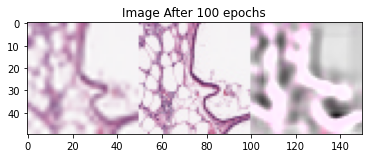

Epoch:100 batch[56/125] loss:0.02200087532401085


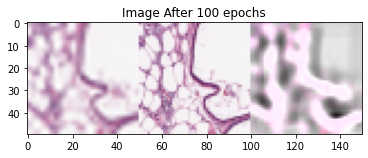

Epoch:100 batch[57/125] loss:0.018752016127109528


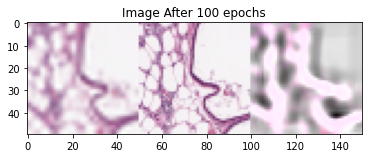

Epoch:100 batch[58/125] loss:0.018010979518294334


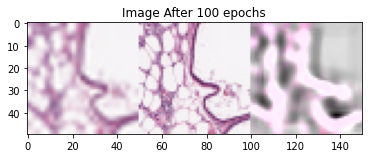

Epoch:100 batch[59/125] loss:0.020828573033213615


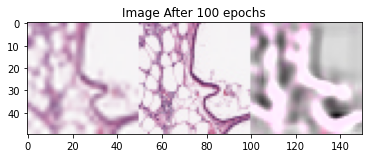

Epoch:100 batch[60/125] loss:0.025630928575992584


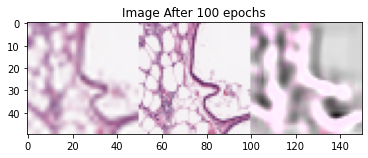

Epoch:100 batch[61/125] loss:0.02290238067507744


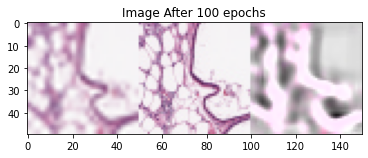

Epoch:100 batch[62/125] loss:0.020450761541724205


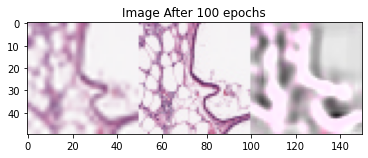

Epoch:100 batch[63/125] loss:0.02440510131418705


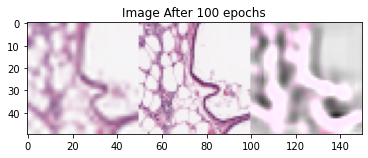

Epoch:100 batch[64/125] loss:0.018256668001413345


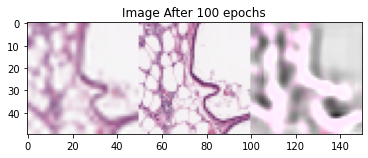

Epoch:100 batch[65/125] loss:0.018711091950535774


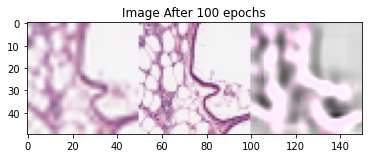

Epoch:100 batch[66/125] loss:0.017325447872281075


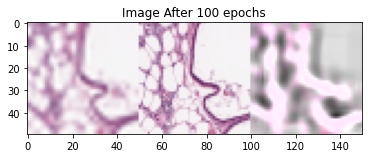

Epoch:100 batch[67/125] loss:0.019121559336781502


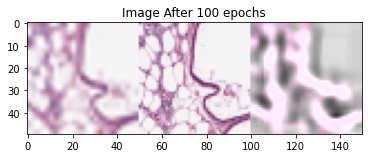

Epoch:100 batch[68/125] loss:0.020718663930892944


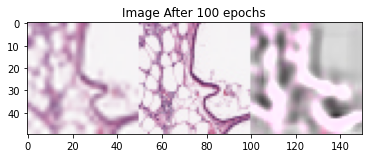

Epoch:100 batch[69/125] loss:0.02499214932322502


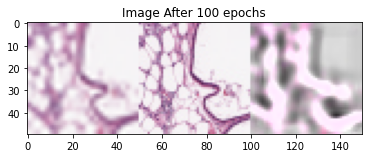

Epoch:100 batch[70/125] loss:0.021781785413622856


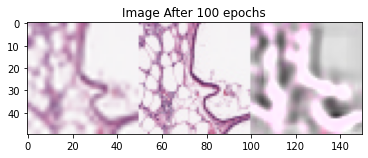

Epoch:100 batch[71/125] loss:0.01733350194990635


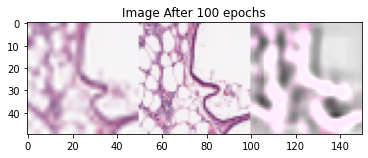

Epoch:100 batch[72/125] loss:0.019360680133104324


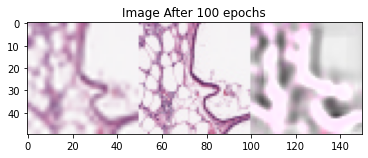

Epoch:100 batch[73/125] loss:0.021103493869304657


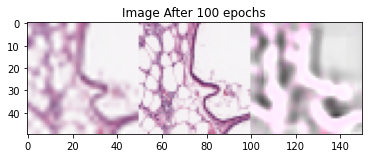

Epoch:100 batch[74/125] loss:0.019776208326220512


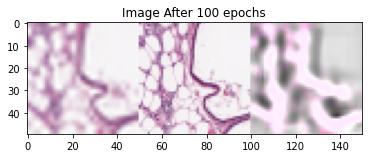

Epoch:100 batch[75/125] loss:0.01869446597993374


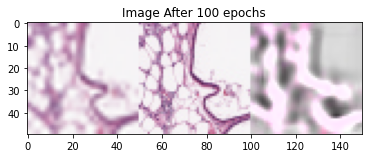

Epoch:100 batch[76/125] loss:0.01738530769944191


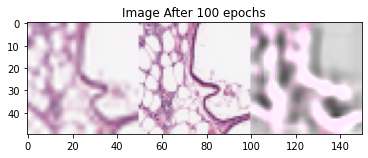

Epoch:100 batch[77/125] loss:0.022953948006033897


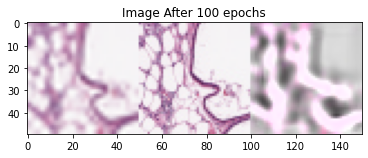

Epoch:100 batch[78/125] loss:0.015095852315425873


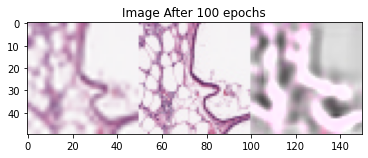

Epoch:100 batch[79/125] loss:0.019918430596590042


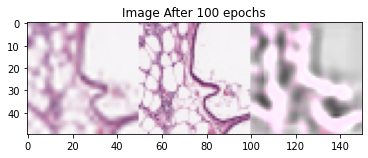

Epoch:100 batch[80/125] loss:0.025336608290672302


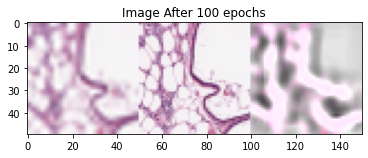

Epoch:100 batch[81/125] loss:0.025059038773179054


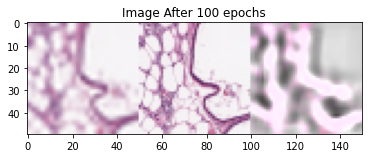

Epoch:100 batch[82/125] loss:0.021349383518099785


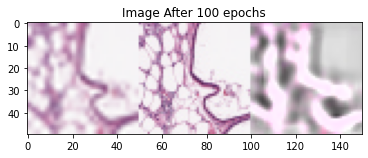

Epoch:100 batch[83/125] loss:0.022171800956130028


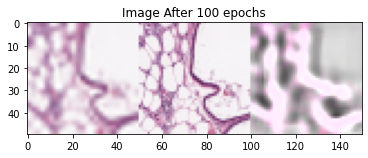

Epoch:100 batch[84/125] loss:0.0161848496645689


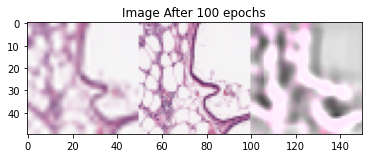

Epoch:100 batch[85/125] loss:0.020978206768631935


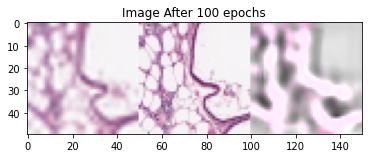

Epoch:100 batch[86/125] loss:0.01807047426700592


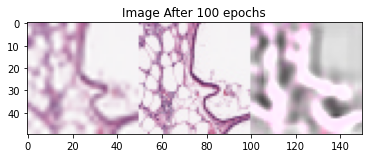

Epoch:100 batch[87/125] loss:0.023559466004371643


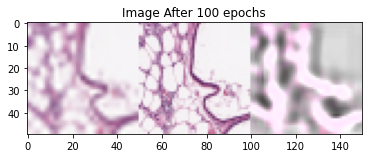

Epoch:100 batch[88/125] loss:0.02033284120261669


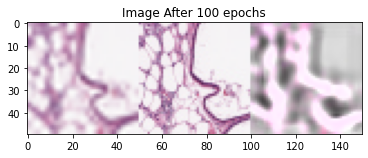

Epoch:100 batch[89/125] loss:0.01796753890812397


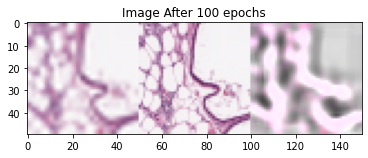

Epoch:100 batch[90/125] loss:0.021149897947907448


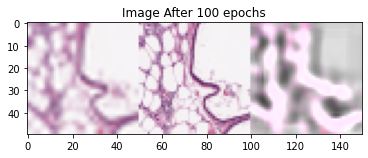

Epoch:100 batch[91/125] loss:0.02041238732635975


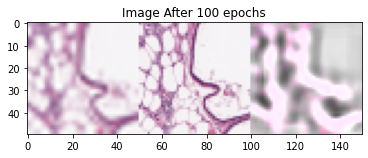

Epoch:100 batch[92/125] loss:0.022418418899178505


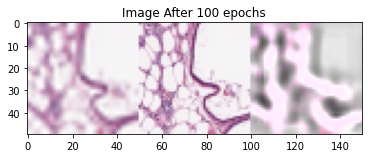

Epoch:100 batch[93/125] loss:0.021335884928703308


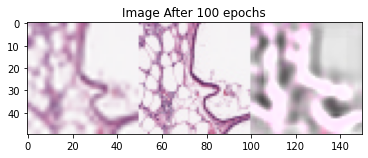

Epoch:100 batch[94/125] loss:0.01906704530119896


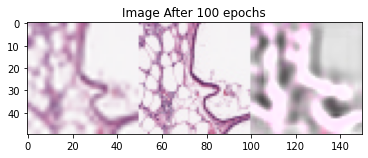

Epoch:100 batch[95/125] loss:0.018909484148025513


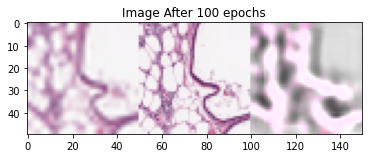

Epoch:100 batch[96/125] loss:0.019792748615145683


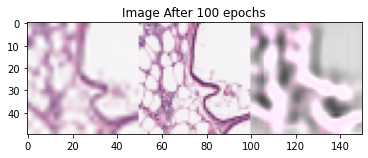

Epoch:100 batch[97/125] loss:0.019724223762750626


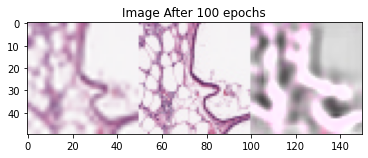

Epoch:100 batch[98/125] loss:0.017959563061594963


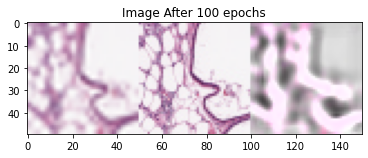

Epoch:100 batch[99/125] loss:0.02221287414431572


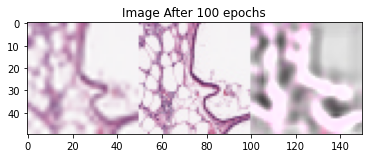

Epoch:100 batch[100/125] loss:0.01961669698357582


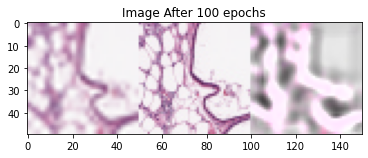

Epoch:100 batch[101/125] loss:0.02074034884572029


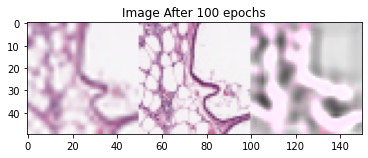

Epoch:100 batch[102/125] loss:0.02533276565372944


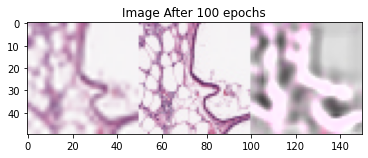

Epoch:100 batch[103/125] loss:0.023497488349676132


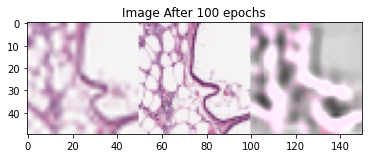

Epoch:100 batch[104/125] loss:0.020107345655560493


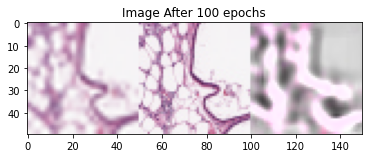

Epoch:100 batch[105/125] loss:0.01972644217312336


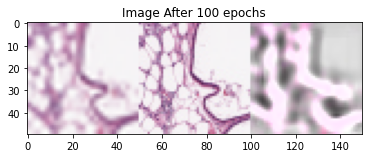

Epoch:100 batch[106/125] loss:0.0200839601457119


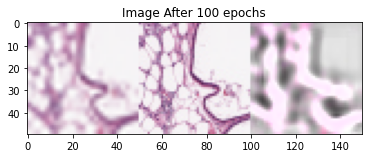

Epoch:100 batch[107/125] loss:0.019160615280270576


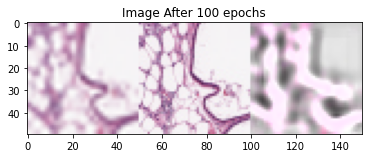

Epoch:100 batch[108/125] loss:0.02185278944671154


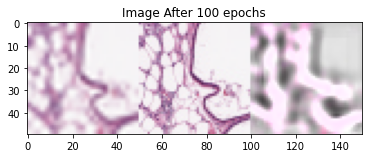

Epoch:100 batch[109/125] loss:0.02157437801361084


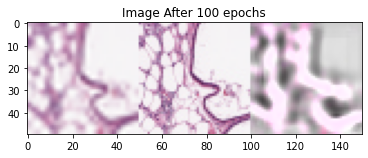

Epoch:100 batch[110/125] loss:0.018991392105817795


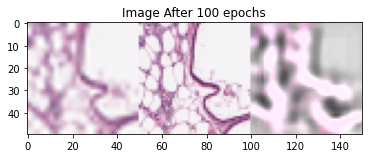

Epoch:100 batch[111/125] loss:0.021586153656244278


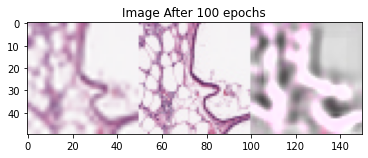

Epoch:100 batch[112/125] loss:0.02063966542482376


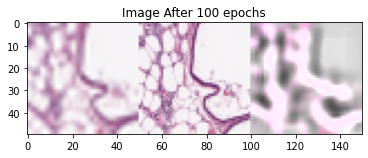

Epoch:100 batch[113/125] loss:0.017937880009412766


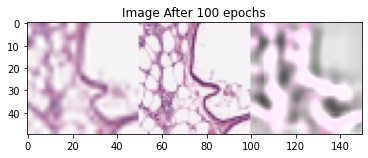

Epoch:100 batch[114/125] loss:0.020154042169451714


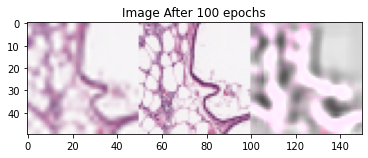

Epoch:100 batch[115/125] loss:0.016798460856080055


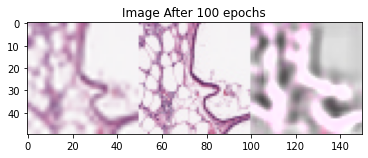

Epoch:100 batch[116/125] loss:0.019285274669528008


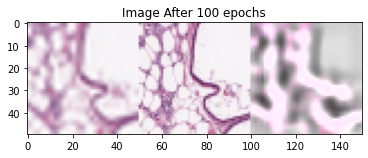

Epoch:100 batch[117/125] loss:0.018668554723262787


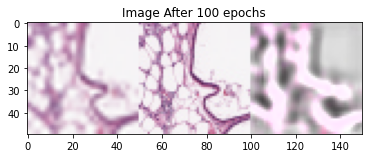

Epoch:100 batch[118/125] loss:0.021473614498972893


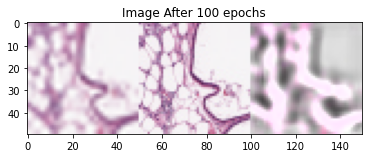

Epoch:100 batch[119/125] loss:0.019911587238311768


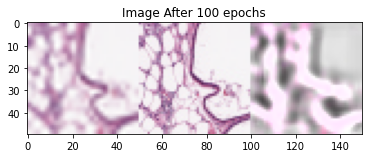

Epoch:100 batch[120/125] loss:0.020926840603351593


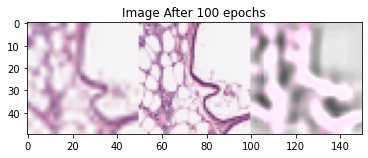

Epoch:100 batch[121/125] loss:0.01602022908627987


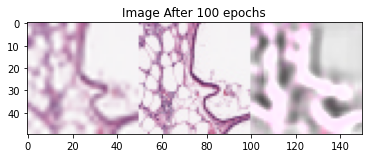

Epoch:100 batch[122/125] loss:0.02214037999510765


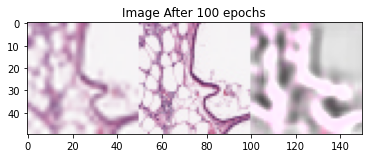

Epoch:100 batch[123/125] loss:0.016486378386616707


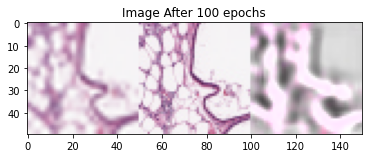

Epoch:100 batch[124/125] loss:0.019700823351740837


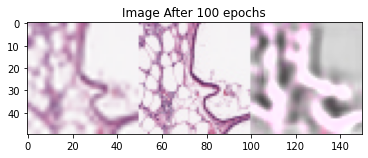

Epoch:200 batch[0/125] loss:0.01700194738805294


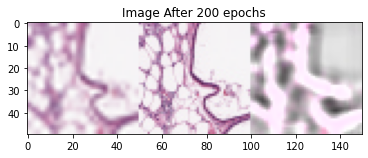

Epoch:200 batch[1/125] loss:0.0247468464076519


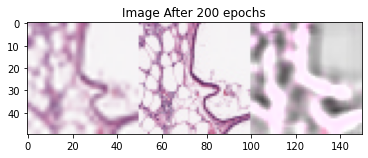

Epoch:200 batch[2/125] loss:0.017041722312569618


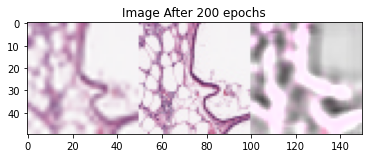

Epoch:200 batch[3/125] loss:0.019793374463915825


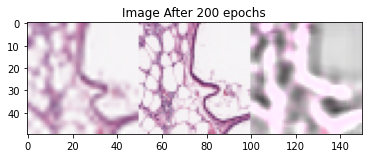

Epoch:200 batch[4/125] loss:0.023606613278388977


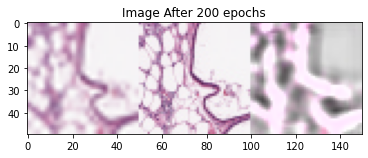

Epoch:200 batch[5/125] loss:0.020447570830583572


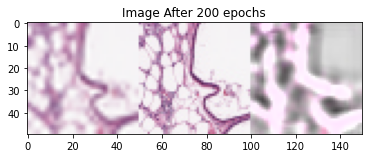

Epoch:200 batch[6/125] loss:0.02027326636016369


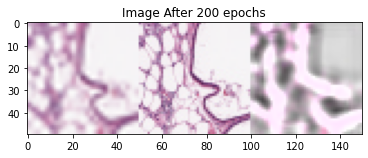

Epoch:200 batch[7/125] loss:0.019883574917912483


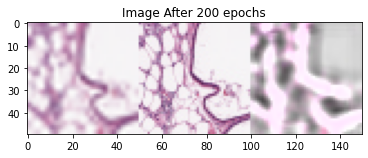

Epoch:200 batch[8/125] loss:0.018419425934553146


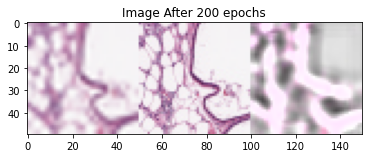

Epoch:200 batch[9/125] loss:0.022018413990736008


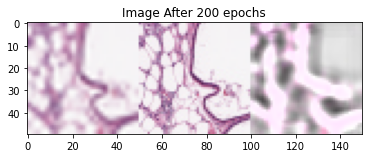

Epoch:200 batch[10/125] loss:0.017364295199513435


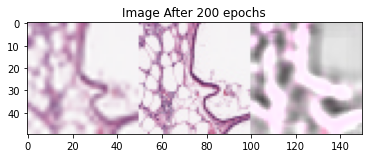

Epoch:200 batch[11/125] loss:0.01936957612633705


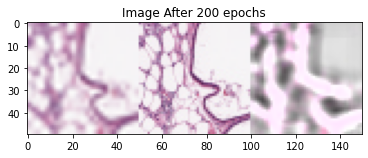

Epoch:200 batch[12/125] loss:0.019488096237182617


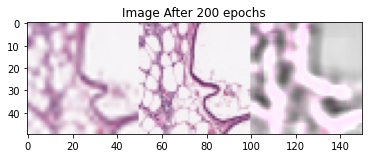

Epoch:200 batch[13/125] loss:0.018625013530254364


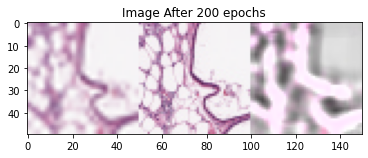

Epoch:200 batch[14/125] loss:0.019766082987189293


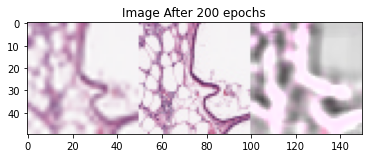

Epoch:200 batch[15/125] loss:0.02070704661309719


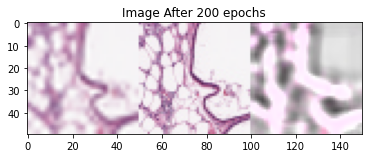

Epoch:200 batch[16/125] loss:0.019596682861447334


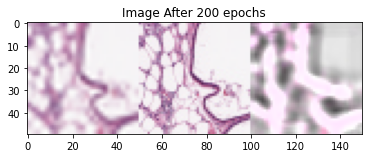

Epoch:200 batch[17/125] loss:0.018290851265192032


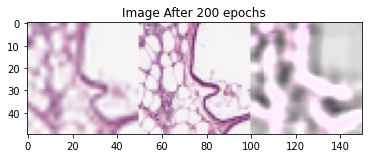

Epoch:200 batch[18/125] loss:0.019565889611840248


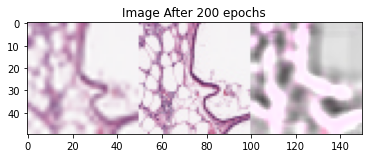

Epoch:200 batch[19/125] loss:0.01931321620941162


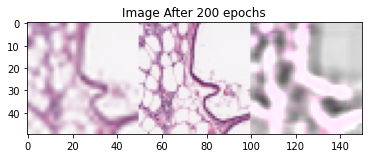

Epoch:200 batch[20/125] loss:0.021894073113799095


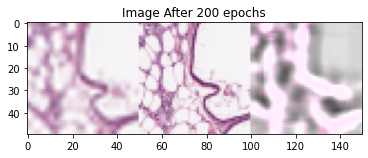

Epoch:200 batch[21/125] loss:0.01930064707994461


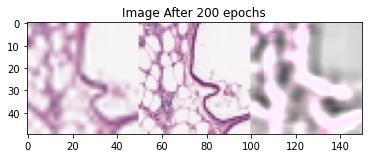

Epoch:200 batch[22/125] loss:0.01977023109793663


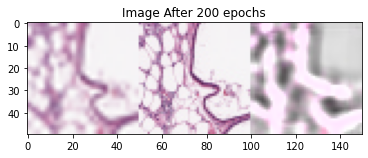

Epoch:200 batch[23/125] loss:0.01867562346160412


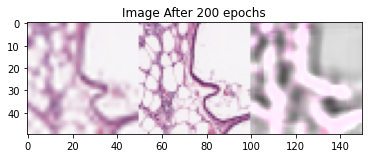

Epoch:200 batch[24/125] loss:0.02161230333149433


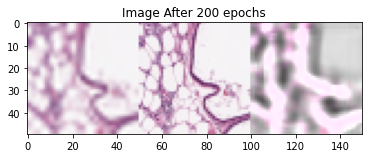

Epoch:200 batch[25/125] loss:0.02010687254369259


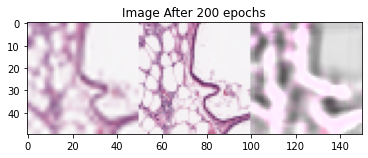

Epoch:200 batch[26/125] loss:0.018984507769346237


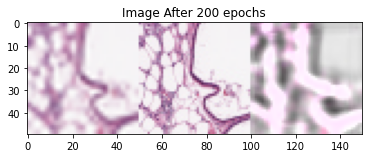

Epoch:200 batch[27/125] loss:0.01869937777519226


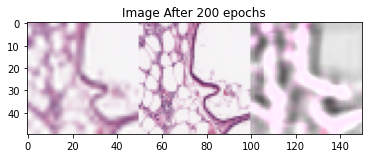

Epoch:200 batch[28/125] loss:0.018864447250962257


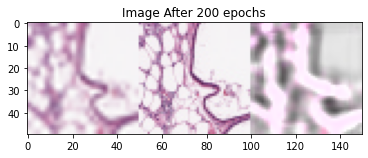

Epoch:200 batch[29/125] loss:0.019474226981401443


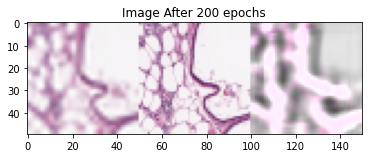

Epoch:200 batch[30/125] loss:0.01853933371603489


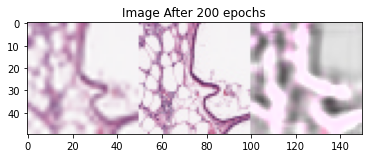

Epoch:200 batch[31/125] loss:0.020232317969202995


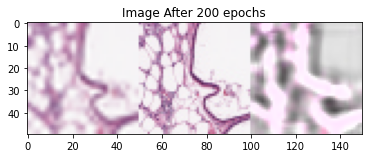

Epoch:200 batch[32/125] loss:0.019047969952225685


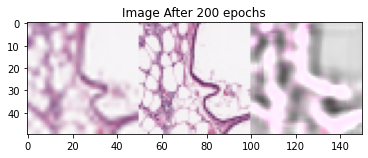

Epoch:200 batch[33/125] loss:0.01888344995677471


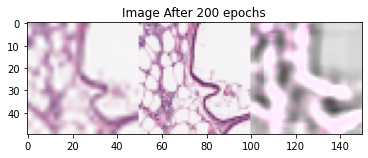

Epoch:200 batch[34/125] loss:0.019091088324785233


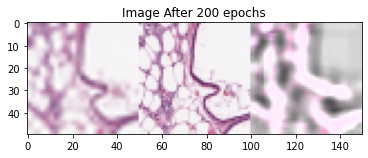

Epoch:200 batch[35/125] loss:0.018220925703644753


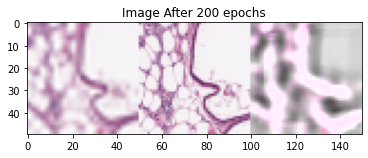

Epoch:200 batch[36/125] loss:0.021707680076360703


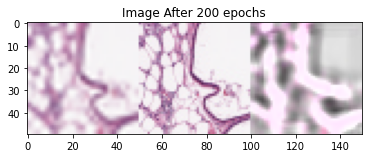

Epoch:200 batch[37/125] loss:0.021715931594371796


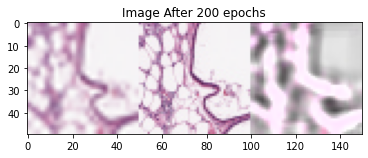

Epoch:200 batch[38/125] loss:0.019410818815231323


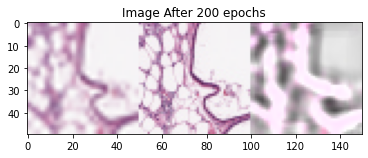

Epoch:200 batch[39/125] loss:0.01676427572965622


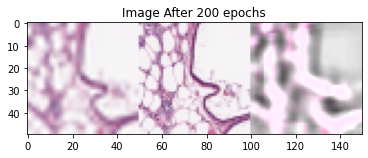

Epoch:200 batch[40/125] loss:0.022288132458925247


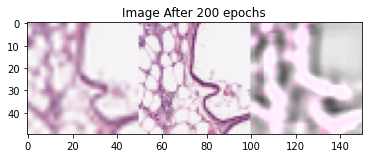

Epoch:200 batch[41/125] loss:0.02052549086511135


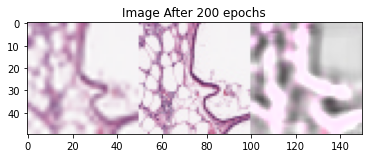

Epoch:200 batch[42/125] loss:0.017986010760068893


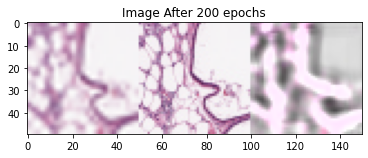

Epoch:200 batch[43/125] loss:0.021661346778273582


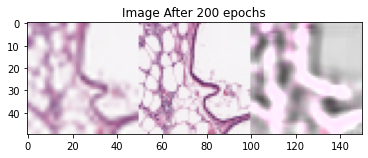

Epoch:200 batch[44/125] loss:0.020195139572024345


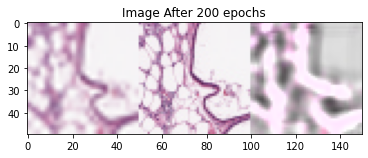

Epoch:200 batch[45/125] loss:0.018130885437130928


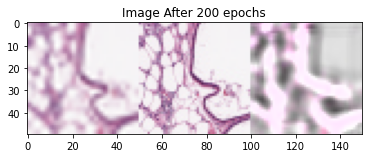

Epoch:200 batch[46/125] loss:0.018142763525247574


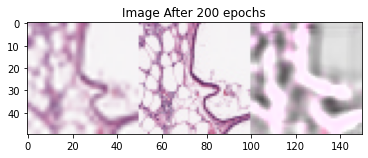

Epoch:200 batch[47/125] loss:0.02071622759103775


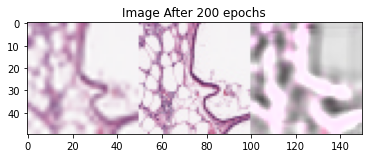

Epoch:200 batch[48/125] loss:0.021237485110759735


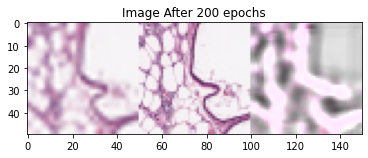

Epoch:200 batch[49/125] loss:0.021062441170215607


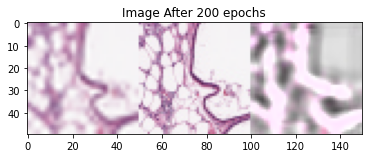

Epoch:200 batch[50/125] loss:0.023032119497656822


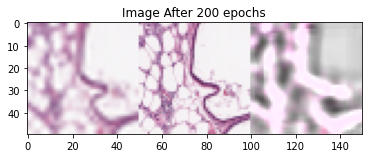

Epoch:200 batch[51/125] loss:0.02185664139688015


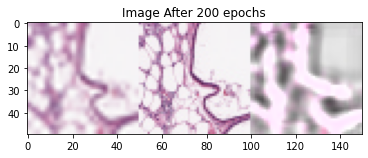

Epoch:200 batch[52/125] loss:0.018722493201494217


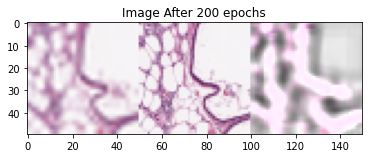

Epoch:200 batch[53/125] loss:0.016221703961491585


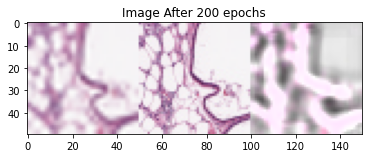

Epoch:200 batch[54/125] loss:0.021304316818714142


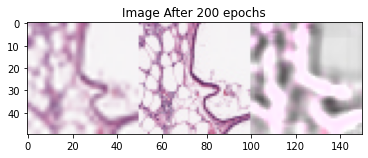

Epoch:200 batch[55/125] loss:0.020489880815148354


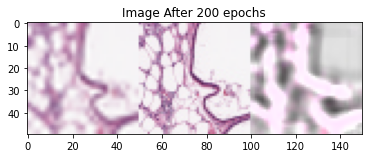

Epoch:200 batch[56/125] loss:0.0207368116825819


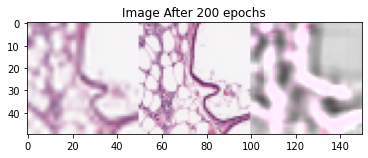

Epoch:200 batch[57/125] loss:0.020931068807840347


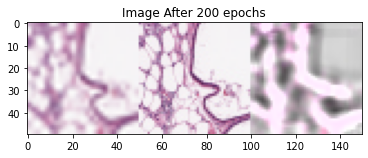

Epoch:200 batch[58/125] loss:0.018618855625391006


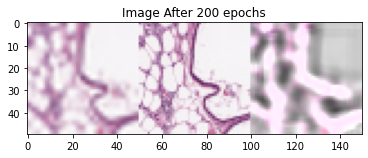

Epoch:200 batch[59/125] loss:0.022601474076509476


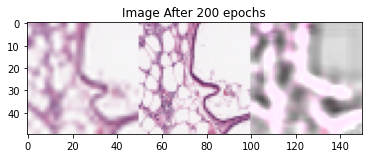

Epoch:200 batch[60/125] loss:0.01828223653137684


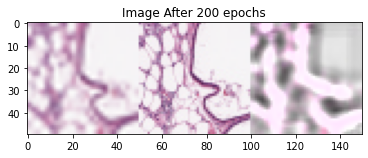

Epoch:200 batch[61/125] loss:0.019708169624209404


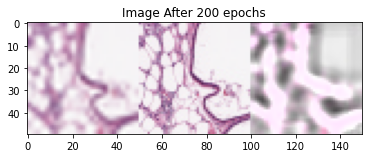

Epoch:200 batch[62/125] loss:0.021865399554371834


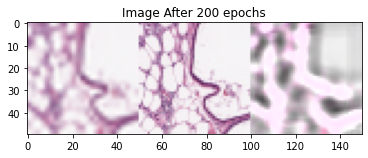

Epoch:200 batch[63/125] loss:0.01989123225212097


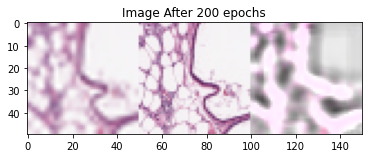

Epoch:200 batch[64/125] loss:0.02331613376736641


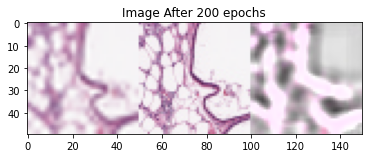

Epoch:200 batch[65/125] loss:0.018910622224211693


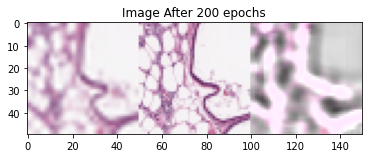

Epoch:200 batch[66/125] loss:0.023352522403001785


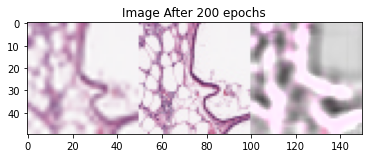

Epoch:200 batch[67/125] loss:0.017849566414952278


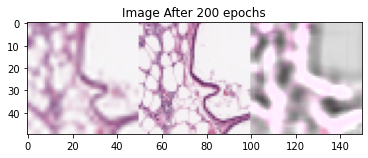

Epoch:200 batch[68/125] loss:0.01925087347626686


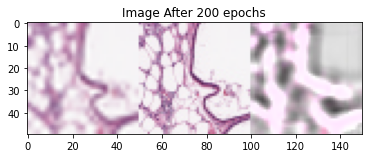

Epoch:200 batch[69/125] loss:0.026555534452199936


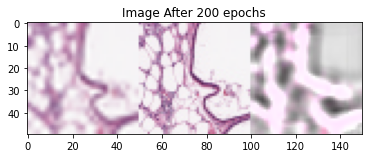

Epoch:200 batch[70/125] loss:0.017277691513299942


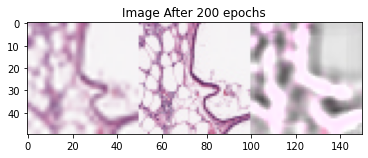

Epoch:200 batch[71/125] loss:0.017026279121637344


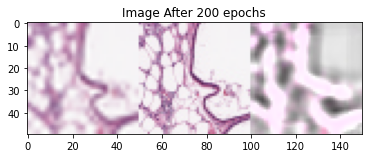

Epoch:200 batch[72/125] loss:0.02044154889881611


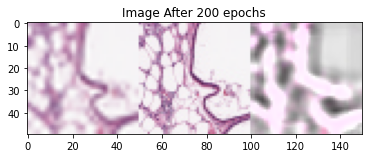

Epoch:200 batch[73/125] loss:0.022065937519073486


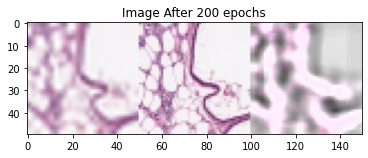

Epoch:200 batch[74/125] loss:0.020577801391482353


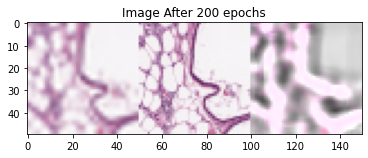

Epoch:200 batch[75/125] loss:0.01972632110118866


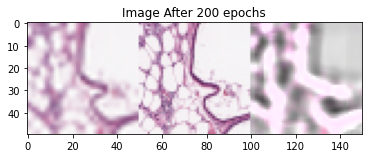

Epoch:200 batch[76/125] loss:0.020067809149622917


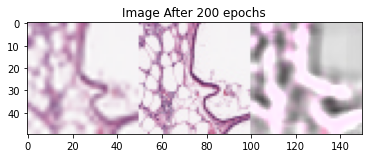

Epoch:200 batch[77/125] loss:0.020005779340863228


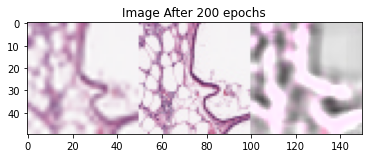

Epoch:200 batch[78/125] loss:0.018868563696742058


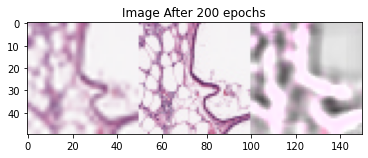

Epoch:200 batch[79/125] loss:0.01981416717171669


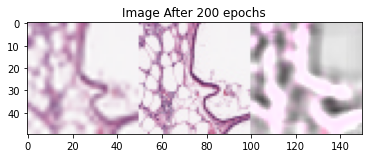

Epoch:200 batch[80/125] loss:0.017204230651259422


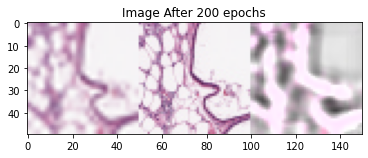

Epoch:200 batch[81/125] loss:0.029934240505099297


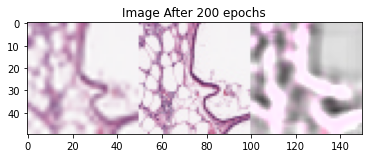

Epoch:200 batch[82/125] loss:0.02205796353518963


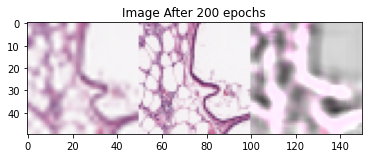

Epoch:200 batch[83/125] loss:0.018588455393910408


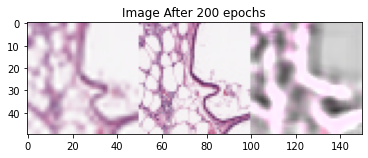

Epoch:200 batch[84/125] loss:0.019212786108255386


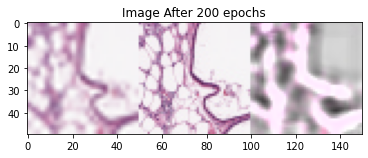

Epoch:200 batch[85/125] loss:0.018741710111498833


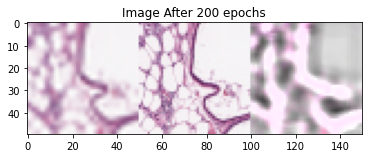

Epoch:200 batch[86/125] loss:0.01920260116457939


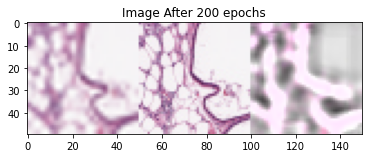

Epoch:200 batch[87/125] loss:0.01747746765613556


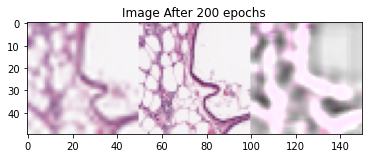

Epoch:200 batch[88/125] loss:0.021110469475388527


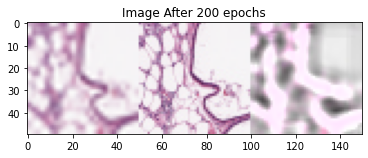

Epoch:200 batch[89/125] loss:0.01930752955377102


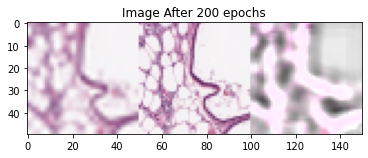

Epoch:200 batch[90/125] loss:0.01775708794593811


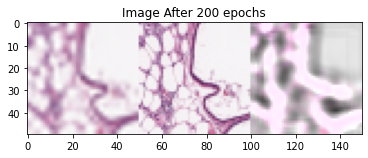

Epoch:200 batch[91/125] loss:0.019684063270688057


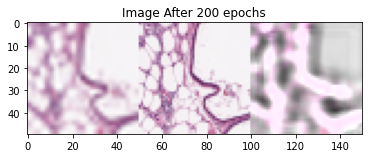

Epoch:200 batch[92/125] loss:0.021069735288619995


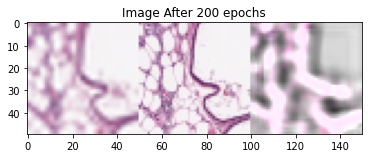

Epoch:200 batch[93/125] loss:0.016837887465953827


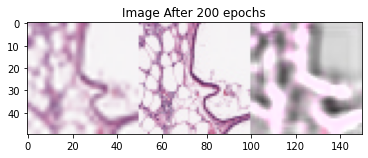

Epoch:200 batch[94/125] loss:0.019301122054457664


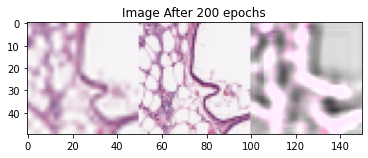

Epoch:200 batch[95/125] loss:0.020329341292381287


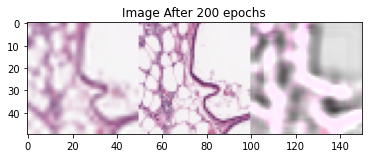

Epoch:200 batch[96/125] loss:0.020418092608451843


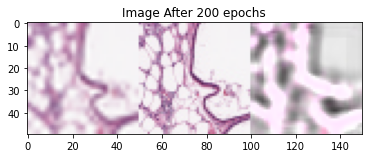

Epoch:200 batch[97/125] loss:0.019711265340447426


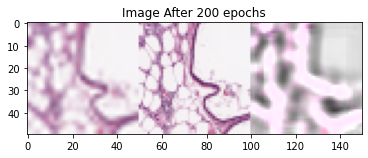

Epoch:200 batch[98/125] loss:0.0188120286911726


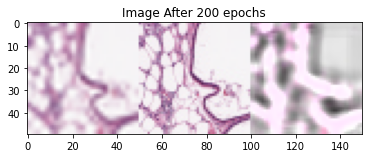

Epoch:200 batch[99/125] loss:0.023749813437461853


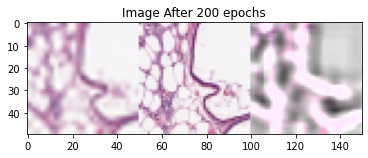

Epoch:200 batch[100/125] loss:0.018001269549131393


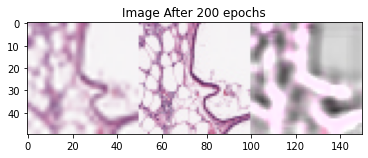

Epoch:200 batch[101/125] loss:0.019670357927680016


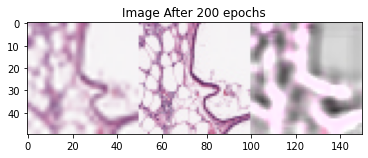

Epoch:200 batch[102/125] loss:0.016949942335486412


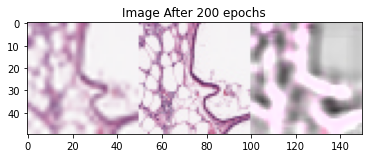

Epoch:200 batch[103/125] loss:0.022639531642198563


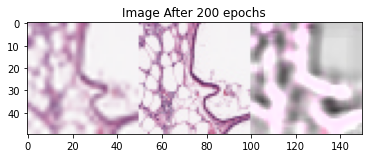

Epoch:200 batch[104/125] loss:0.021700557321310043


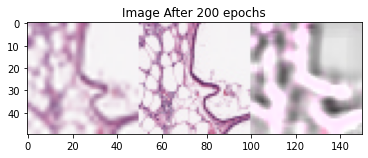

Epoch:200 batch[105/125] loss:0.017542511224746704


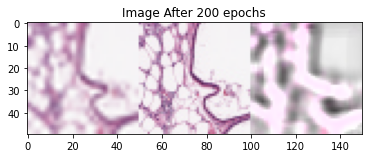

Epoch:200 batch[106/125] loss:0.025994176045060158


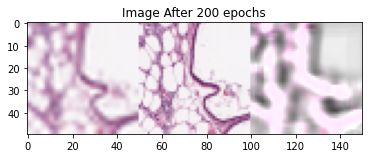

Epoch:200 batch[107/125] loss:0.018094057217240334


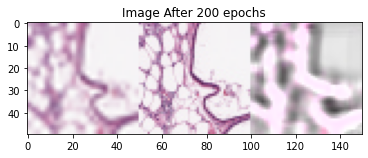

Epoch:200 batch[108/125] loss:0.022817039862275124


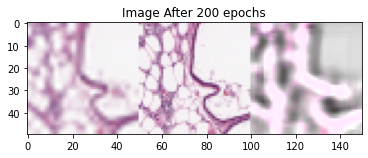

Epoch:200 batch[109/125] loss:0.022041231393814087


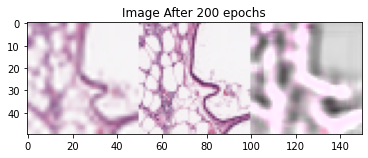

Epoch:200 batch[110/125] loss:0.021808836609125137


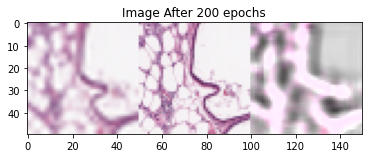

Epoch:200 batch[111/125] loss:0.021088773384690285


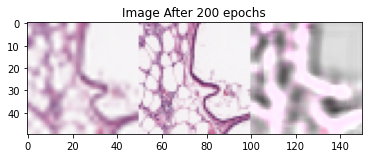

Epoch:200 batch[112/125] loss:0.020189400762319565


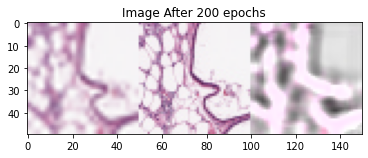

Epoch:200 batch[113/125] loss:0.02066774107515812


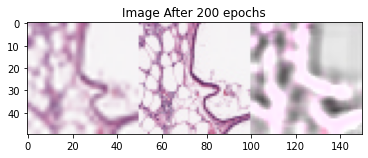

Epoch:200 batch[114/125] loss:0.019958430901169777


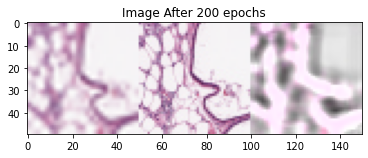

Epoch:200 batch[115/125] loss:0.02109767682850361


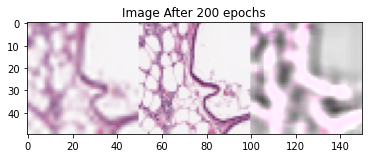

Epoch:200 batch[116/125] loss:0.0205832589417696


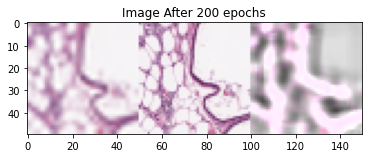

Epoch:200 batch[117/125] loss:0.022007934749126434


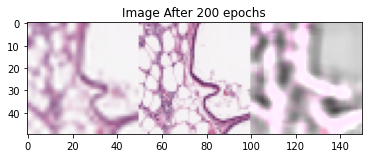

Epoch:200 batch[118/125] loss:0.017937568947672844


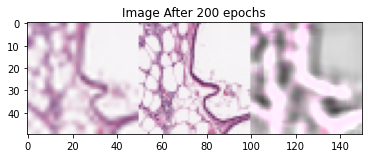

Epoch:200 batch[119/125] loss:0.018170222640037537


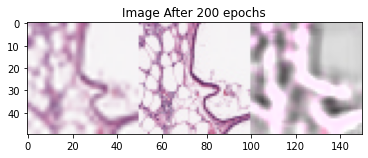

Epoch:200 batch[120/125] loss:0.02016533352434635


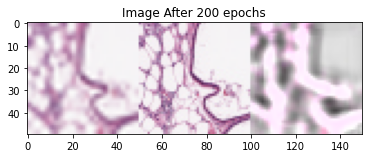

Epoch:200 batch[121/125] loss:0.022721972316503525


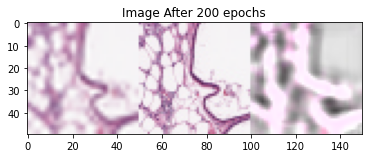

Epoch:200 batch[122/125] loss:0.01763039268553257


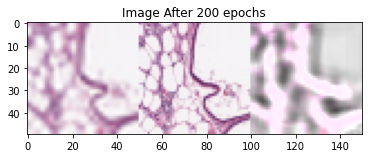

Epoch:200 batch[123/125] loss:0.020633699372410774


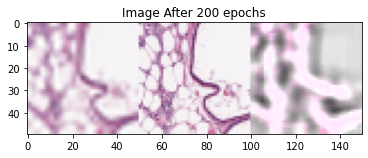

Epoch:200 batch[124/125] loss:0.022185491397976875


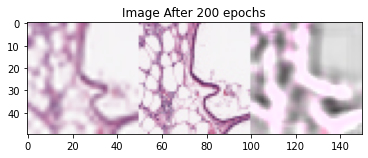

Epoch:300 batch[0/125] loss:0.018072880804538727


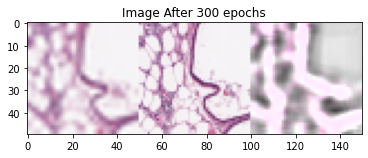

Epoch:300 batch[1/125] loss:0.022938020527362823


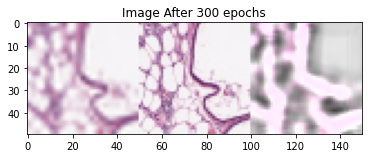

Epoch:300 batch[2/125] loss:0.01702599972486496


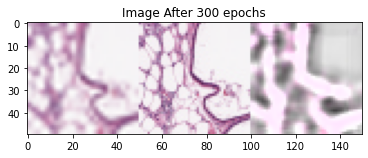

Epoch:300 batch[3/125] loss:0.020372997969388962


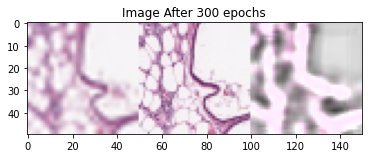

Epoch:300 batch[4/125] loss:0.020978007465600967


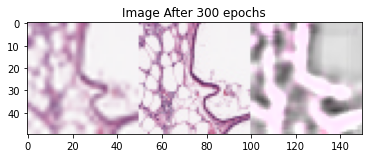

Epoch:300 batch[5/125] loss:0.01880229450762272


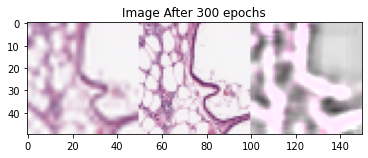

Epoch:300 batch[6/125] loss:0.017183708027005196


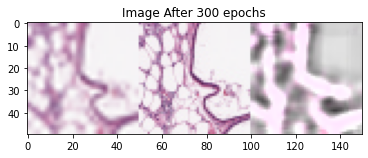

Epoch:300 batch[7/125] loss:0.021370096132159233


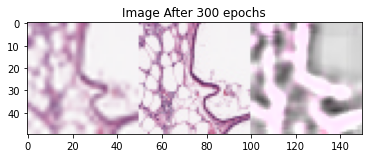

Epoch:300 batch[8/125] loss:0.023557113483548164


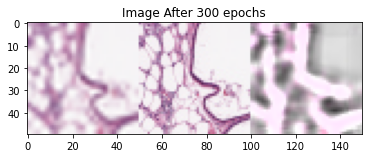

Epoch:300 batch[9/125] loss:0.020374316722154617


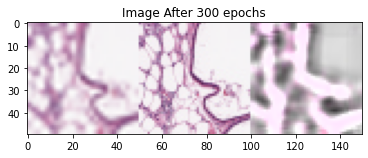

Epoch:300 batch[10/125] loss:0.026396669447422028


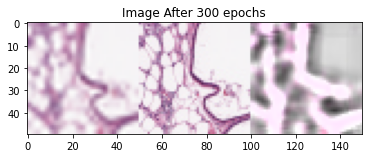

Epoch:300 batch[11/125] loss:0.015983255580067635


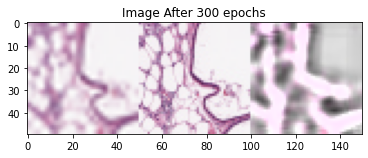

Epoch:300 batch[12/125] loss:0.02472780831158161


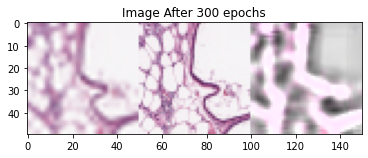

Epoch:300 batch[13/125] loss:0.020993592217564583


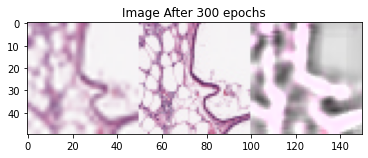

Epoch:300 batch[14/125] loss:0.018843339756131172


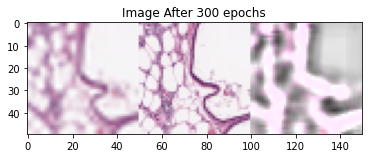

Epoch:300 batch[15/125] loss:0.0184960775077343


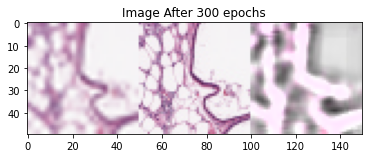

Epoch:300 batch[16/125] loss:0.021189458668231964


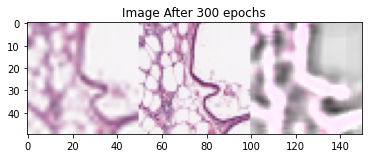

Epoch:300 batch[17/125] loss:0.02019861713051796


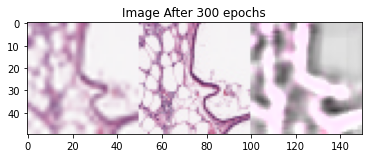

Epoch:300 batch[18/125] loss:0.022875458002090454


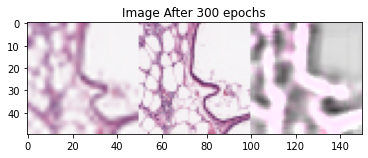

Epoch:300 batch[19/125] loss:0.019455235451459885


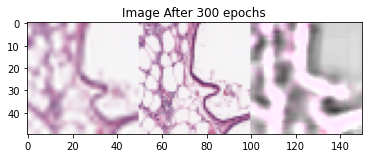

Epoch:300 batch[20/125] loss:0.018476217985153198


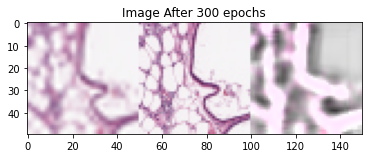

Epoch:300 batch[21/125] loss:0.020980166271328926


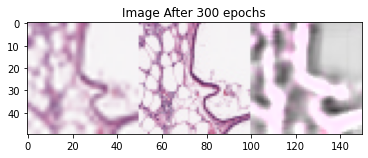

Epoch:300 batch[22/125] loss:0.021036474034190178


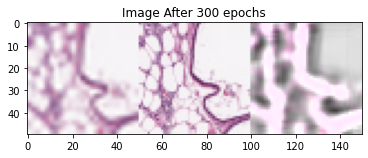

Epoch:300 batch[23/125] loss:0.019841140136122704


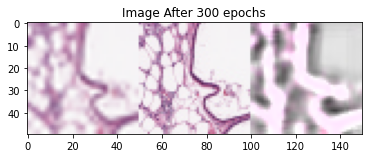

Epoch:300 batch[24/125] loss:0.018300948664546013


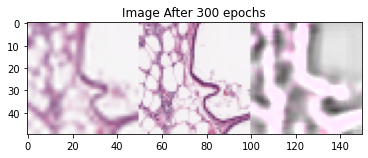

Epoch:300 batch[25/125] loss:0.018594859167933464


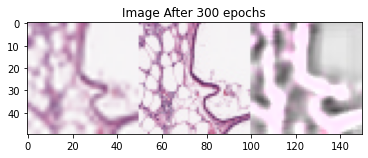

Epoch:300 batch[26/125] loss:0.021219337359070778


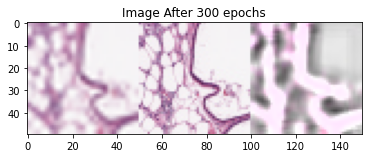

Epoch:300 batch[27/125] loss:0.022094126790761948


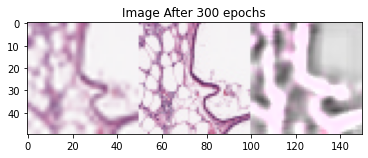

Epoch:300 batch[28/125] loss:0.017651479691267014


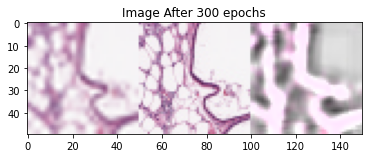

Epoch:300 batch[29/125] loss:0.019784890115261078


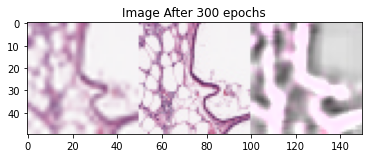

Epoch:300 batch[30/125] loss:0.01889028772711754


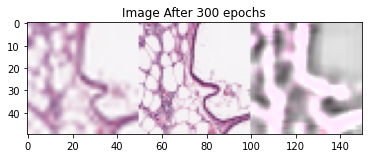

Epoch:300 batch[31/125] loss:0.01919463463127613


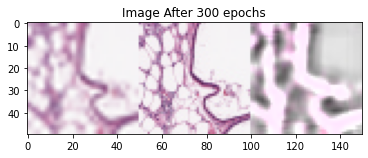

Epoch:300 batch[32/125] loss:0.01449569035321474


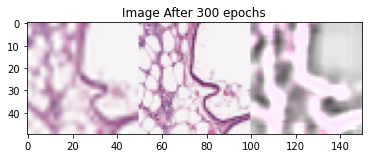

Epoch:300 batch[33/125] loss:0.0224393829703331


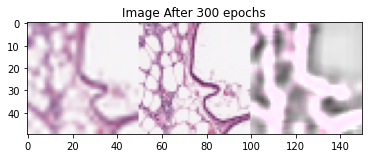

Epoch:300 batch[34/125] loss:0.02006726711988449


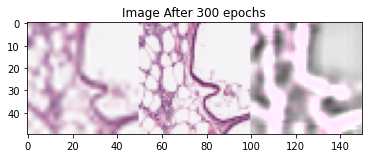

Epoch:300 batch[35/125] loss:0.02014020085334778


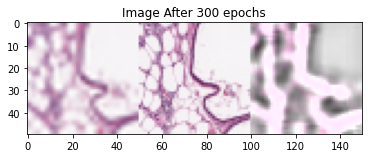

Epoch:300 batch[36/125] loss:0.018971210345625877


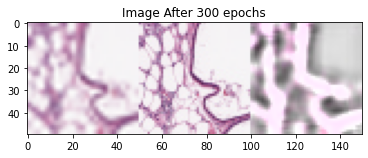

Epoch:300 batch[37/125] loss:0.017707252874970436


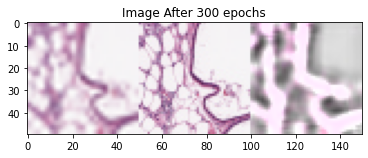

Epoch:300 batch[38/125] loss:0.021493807435035706


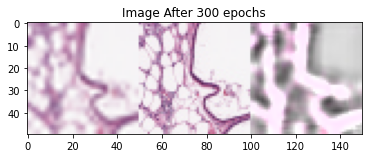

Epoch:300 batch[39/125] loss:0.015855034813284874


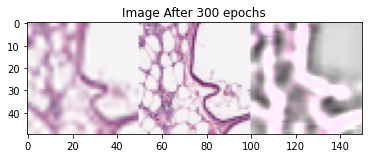

Epoch:300 batch[40/125] loss:0.020566340535879135


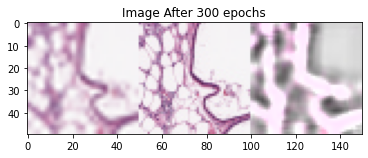

Epoch:300 batch[41/125] loss:0.02249186858534813


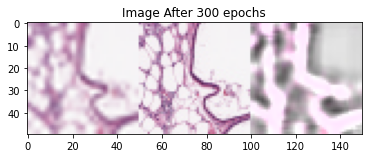

Epoch:300 batch[42/125] loss:0.020463917404413223


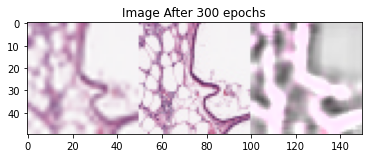

Epoch:300 batch[43/125] loss:0.022072048857808113


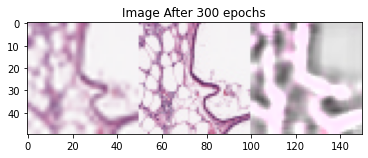

Epoch:300 batch[44/125] loss:0.01746985875070095


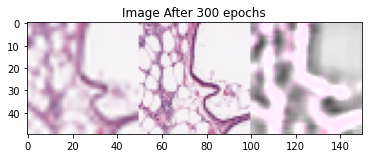

Epoch:300 batch[45/125] loss:0.01793198101222515


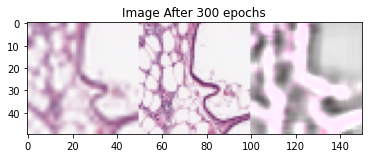

Epoch:300 batch[46/125] loss:0.02048531174659729


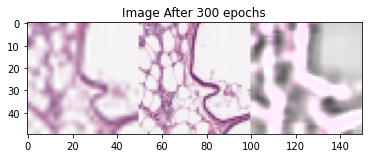

Epoch:300 batch[47/125] loss:0.019702540710568428


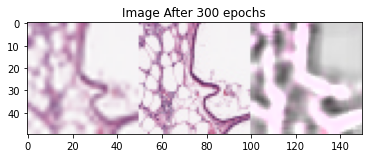

Epoch:300 batch[48/125] loss:0.02186454087495804


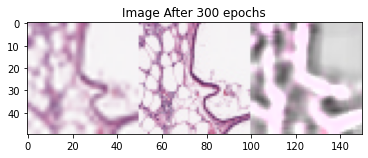

Epoch:300 batch[49/125] loss:0.02002803608775139


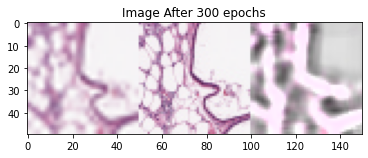

Epoch:300 batch[50/125] loss:0.020058462396264076


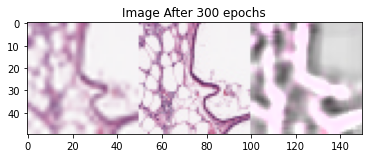

Epoch:300 batch[51/125] loss:0.017696769908070564


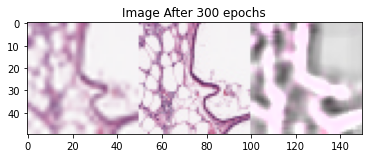

Epoch:300 batch[52/125] loss:0.015466575510799885


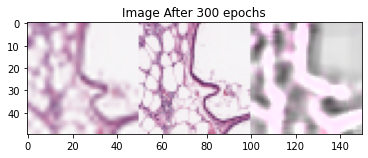

Epoch:300 batch[53/125] loss:0.018155623227357864


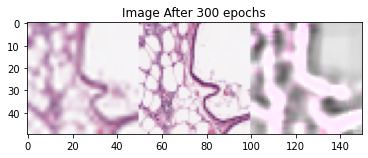

Epoch:300 batch[54/125] loss:0.019915970042347908


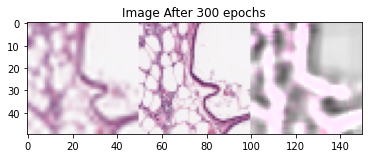

Epoch:300 batch[55/125] loss:0.019462797790765762


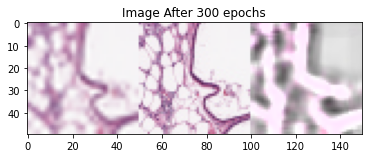

Epoch:300 batch[56/125] loss:0.018411720171570778


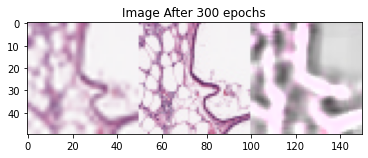

Epoch:300 batch[57/125] loss:0.02430681511759758


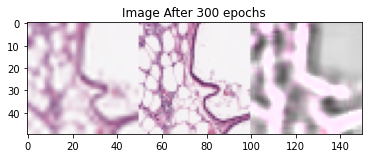

Epoch:300 batch[58/125] loss:0.018034670501947403


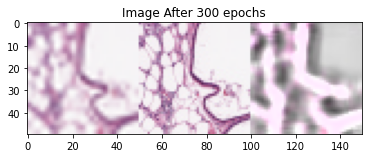

Epoch:300 batch[59/125] loss:0.023278765380382538


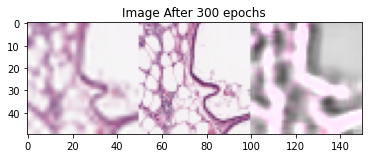

Epoch:300 batch[60/125] loss:0.022295821458101273


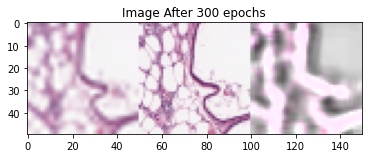

Epoch:300 batch[61/125] loss:0.020061852410435677


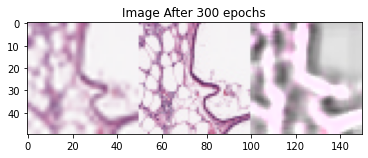

Epoch:300 batch[62/125] loss:0.017785362899303436


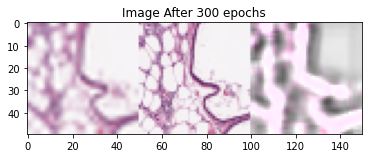

Epoch:300 batch[63/125] loss:0.024911323562264442


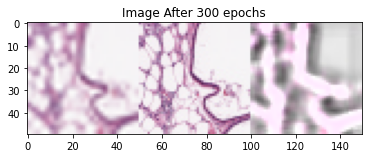

Epoch:300 batch[64/125] loss:0.018642988055944443


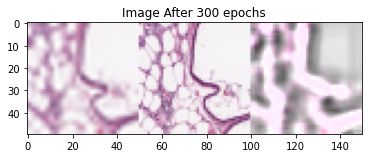

Epoch:300 batch[65/125] loss:0.021082347258925438


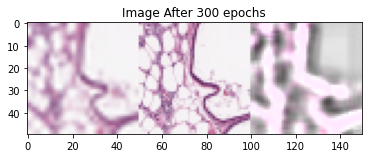

Epoch:300 batch[66/125] loss:0.018157416954636574


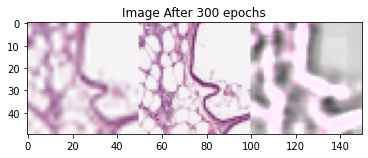

Epoch:300 batch[67/125] loss:0.021298395469784737


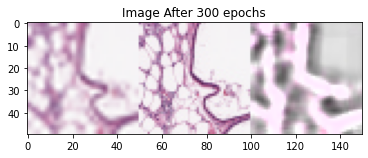

Epoch:300 batch[68/125] loss:0.022090760990977287


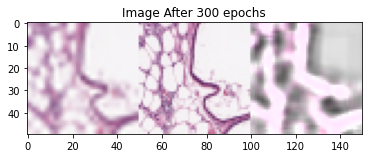

Epoch:300 batch[69/125] loss:0.021935533732175827


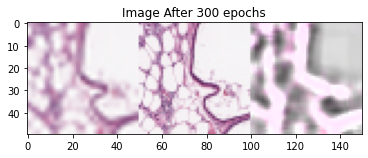

Epoch:300 batch[70/125] loss:0.01818316988646984


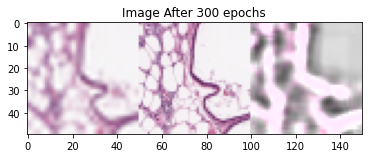

Epoch:300 batch[71/125] loss:0.02354598231613636


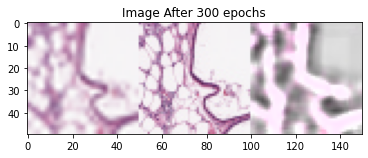

Epoch:300 batch[72/125] loss:0.01757959835231304


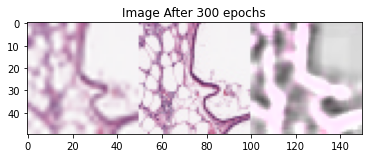

Epoch:300 batch[73/125] loss:0.01977851241827011


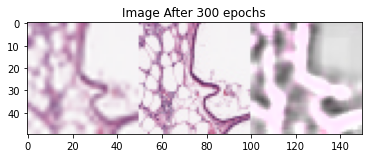

Epoch:300 batch[74/125] loss:0.01795963943004608


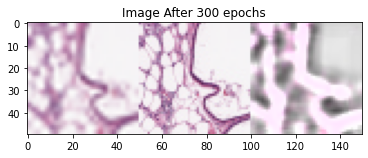

Epoch:300 batch[75/125] loss:0.017994875088334084


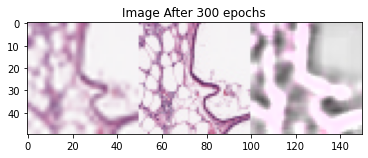

Epoch:300 batch[76/125] loss:0.015637921169400215


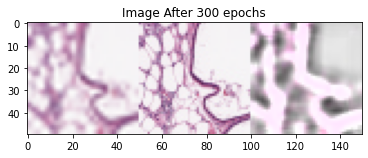

Epoch:300 batch[77/125] loss:0.01785251498222351


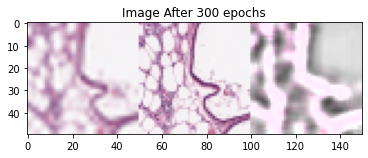

Epoch:300 batch[78/125] loss:0.019872281700372696


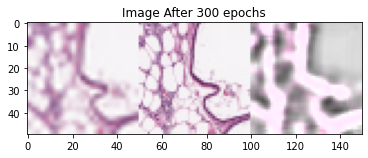

Epoch:300 batch[79/125] loss:0.0240608062595129


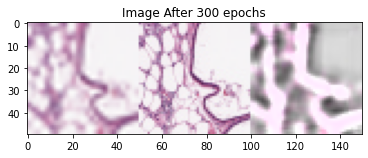

Epoch:300 batch[80/125] loss:0.01978776976466179


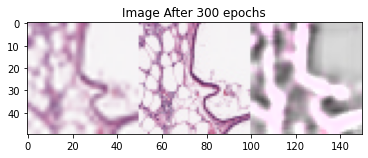

Epoch:300 batch[81/125] loss:0.024063870310783386


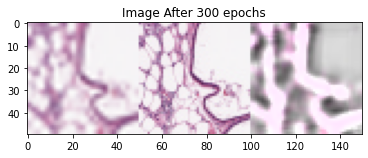

Epoch:300 batch[82/125] loss:0.02063271403312683


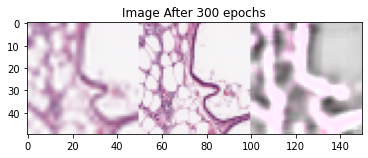

Epoch:300 batch[83/125] loss:0.015840422362089157


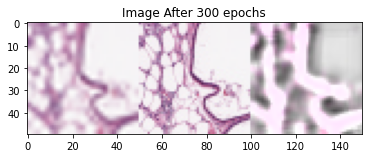

Epoch:300 batch[84/125] loss:0.021044347435235977


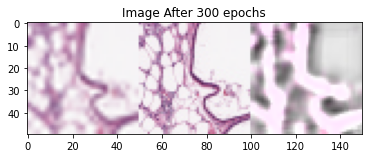

Epoch:300 batch[85/125] loss:0.020436931401491165


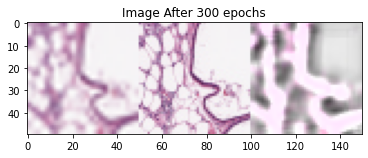

Epoch:300 batch[86/125] loss:0.02401317097246647


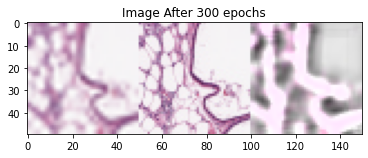

Epoch:300 batch[87/125] loss:0.016394052654504776


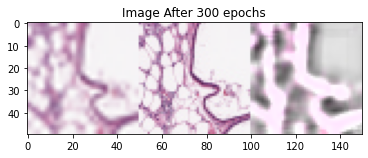

Epoch:300 batch[88/125] loss:0.02117113396525383


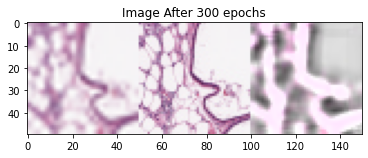

Epoch:300 batch[89/125] loss:0.02091687172651291


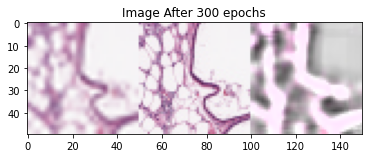

Epoch:300 batch[90/125] loss:0.019505111500620842


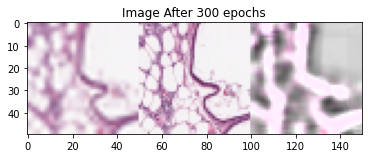

Epoch:300 batch[91/125] loss:0.01810588873922825


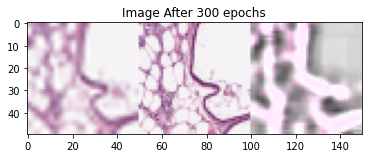

Epoch:300 batch[92/125] loss:0.017626602202653885


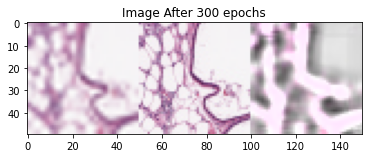

Epoch:300 batch[93/125] loss:0.01964285783469677


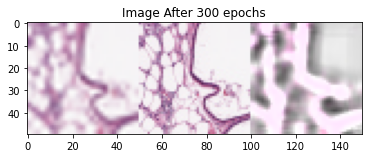

Epoch:300 batch[94/125] loss:0.01915867254137993


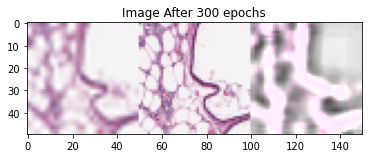

Epoch:300 batch[95/125] loss:0.023617669939994812


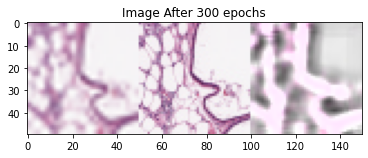

Epoch:300 batch[96/125] loss:0.021981844678521156


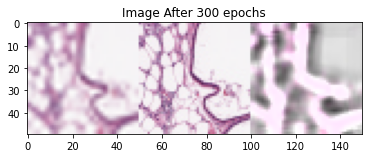

Epoch:300 batch[97/125] loss:0.01584831438958645


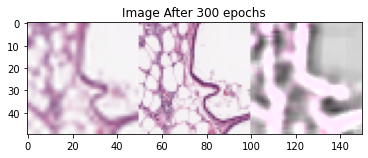

Epoch:300 batch[98/125] loss:0.021063024178147316


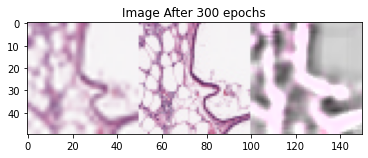

Epoch:300 batch[99/125] loss:0.019744839519262314


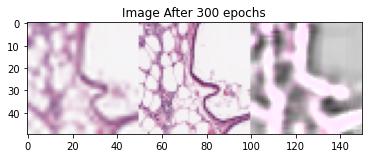

Epoch:300 batch[100/125] loss:0.01937323808670044


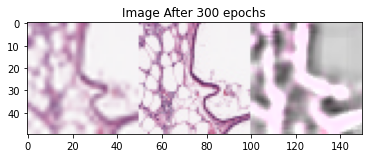

Epoch:300 batch[101/125] loss:0.01958383619785309


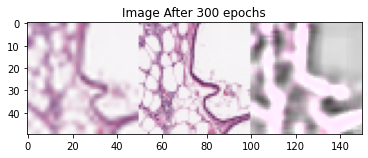

Epoch:300 batch[102/125] loss:0.018255887553095818


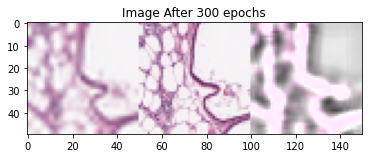

Epoch:300 batch[103/125] loss:0.02143491990864277


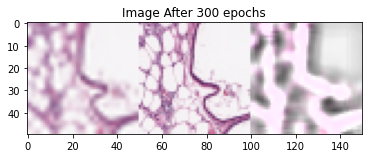

Epoch:300 batch[104/125] loss:0.019576363265514374


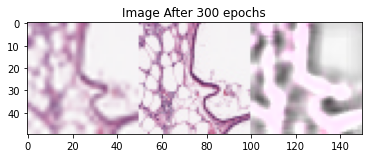

Epoch:300 batch[105/125] loss:0.020897429436445236


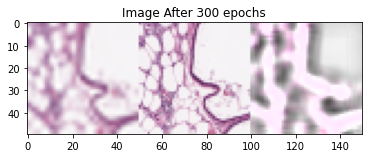

Epoch:300 batch[106/125] loss:0.02129102125763893


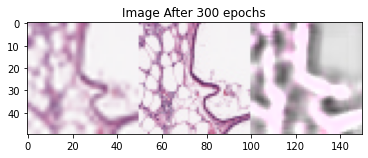

Epoch:300 batch[107/125] loss:0.01928114891052246


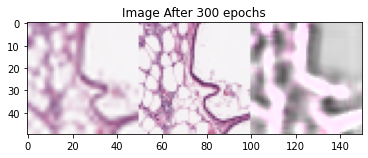

Epoch:300 batch[108/125] loss:0.019635668024420738


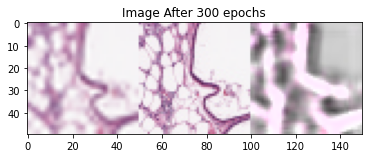

Epoch:300 batch[109/125] loss:0.02178715355694294


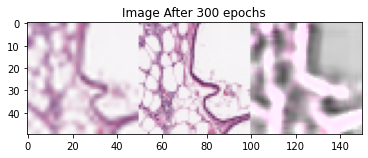

Epoch:300 batch[110/125] loss:0.01919144205749035


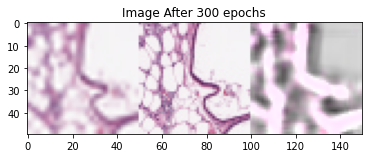

Epoch:300 batch[111/125] loss:0.0214228518307209


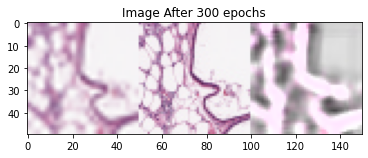

Epoch:300 batch[112/125] loss:0.020585274323821068


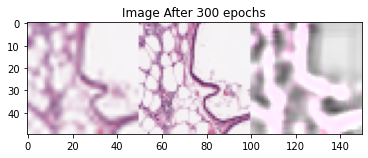

Epoch:300 batch[113/125] loss:0.016280705109238625


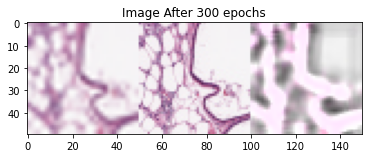

Epoch:300 batch[114/125] loss:0.019197115674614906


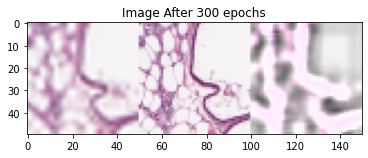

Epoch:300 batch[115/125] loss:0.02096559666097164


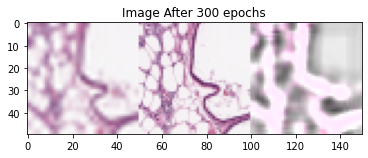

Epoch:300 batch[116/125] loss:0.021602727472782135


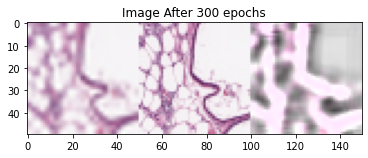

Epoch:300 batch[117/125] loss:0.020238351076841354


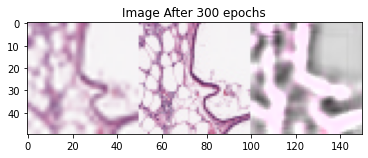

Epoch:300 batch[118/125] loss:0.019220251590013504


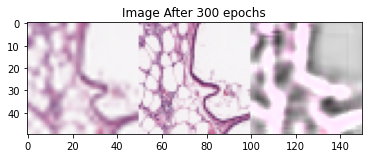

Epoch:300 batch[119/125] loss:0.021882668137550354


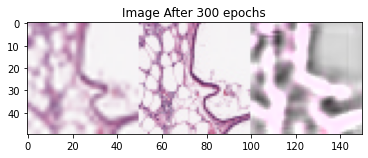

Epoch:300 batch[120/125] loss:0.019215328618884087


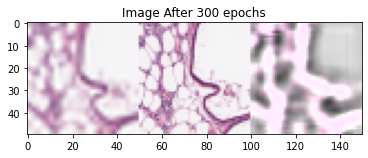

Epoch:300 batch[121/125] loss:0.020845791324973106


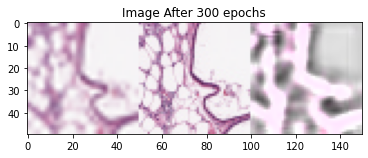

Epoch:300 batch[122/125] loss:0.01910007931292057


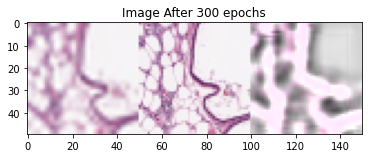

Epoch:300 batch[123/125] loss:0.019367117434740067


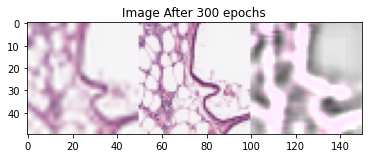

Epoch:300 batch[124/125] loss:0.021992895752191544


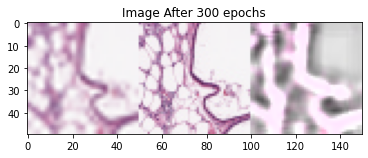

In [13]:
n_epochs=300
train(NUM_EPOCHS=n_epochs)

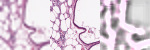

In [14]:
Image.open(f'/tmp/image/image{n_epochs}.png')

In [ ]:
# from IPython.display import FileLink
#FileLink('./image/image.png')
#FileLink('./image/LR.png')
#FileLink('./image/HR.png')
#FileLink('./image/newHR.png')

In [15]:
os.system('mkdir /tmp/HR_1_imgs')
os.system('mkdir /tmp/SR_1_imgs')

0

In [16]:
os.system('mkdir /tmp/HR_0_imgs')
os.system('mkdir /tmp/SR_0_imgs')

0

In [21]:
# total_bicubic_psnr = 0.0
# total_test_psnr = 0.0

for index, test_img_path in enumerate(test_img_pneumonia_paths[:]):
    #print("Epoch:{} batch[{}/{}] loss:{}".format(epoch+1, batch_idx+1, len(train_loader), loss))    
    
    data_transform = Compose([ToTensor()])
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    img = Image.open(test_img_path)   

    w, h = img.size

    result_image = img
    result_image_y, _cb, _cr = result_image.convert('YCbCr').split()
    result_image_y = data_transform(result_image_y)   

    resize_image = img.resize((int(w/3), int(h/3)), Image.BICUBIC)       
    resize_image = resize_image.resize((w, h), Image.BICUBIC)
    resize_image_y, _cb, _cr = resize_image.convert('YCbCr').split()
    resize_image_y = data_transform(resize_image_y).to(device)
    newHR = SRCNN(resize_image_y.unsqueeze(0))
    out_img_y = newHR[0]
    out_img_y *= 255.0
    out_img_y = out_img_y.cpu().data.numpy()
    # Restore the image in RGB color space.
    out_img_y = out_img_y.clip(0, 255)
    out_img_y = out_img_y.reshape((np.shape(out_img_y)[1], np.shape(out_img_y)[2]))
    out_img_y = PIL.Image.fromarray(np.uint8(out_img_y), mode="L")
    out_img_cb = _cb.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img_cr = _cr.resize(out_img_y.size, PIL.Image.BICUBIC)
    out_img = PIL.Image.merge("YCbCr", (out_img_y, out_img_cb, out_img_cr)).convert("RGB")
    
#     plot_results(resize_image_y, index, "lowres")
#     plot_results(result_image_y, index, "highres")
#     plot_results(newHR, index, "prediction")

#     torchvision.utils.save_image(resize_image_y, f'./output/LR{index+1}.png')
    result_image.save(f'/tmp/HR_1_imgs/HR{index+1}.png')
    out_img.save(f'/tmp/SR_1_imgs/SR{index+1}.png')

#     im1 = Image.open(f'./output/LR{index+1}.png')
#     im2 = Image.open(f'./output/HR{index+1}.png')
#     im3 = Image.open(f'./output/newHR{index+1}.png')                
#     dst = Image.new('RGB', (w*3 , h))
#     dst.paste(im1, (0, 0))
#     dst.paste(im2, (w, 0))
#     dst.paste(im3, (w*2, 0))
    
#     dst.save(f'./output/image{index+1}.png')
#     img = Image.open(f'./output/image{index+1}.png')
#     plt.imshow(img)
#     plt.title(f'Test Image {index+1}')
#     plt.show()

In [19]:
%%!

zip -r HR_0_imgs.zip /tmp/HR_0_imgs

['  adding: tmp/HR_0_imgs/ (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR118.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR186.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR208.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR171.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR146.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR25.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR48.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR43.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR218.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR101.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR177.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR125.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR58.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR235.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR209.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR142.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR213.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR212.png (stored 0%)',
 '  adding: tmp/HR_0_imgs/HR67.png (stored 0%)',
 '  adding: tm

In [20]:
%%!

zip -r SR_0_imgs.zip /tmp/SR_0_imgs

['  adding: tmp/SR_0_imgs/ (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR227.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR30.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR56.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR160.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR183.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR75.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR211.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR166.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR225.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR58.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR220.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR19.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR12.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR107.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR153.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR85.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR108.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR125.png (stored 0%)',
 '  adding: tmp/SR_0_imgs/SR221.png (stored 0%)',
 '  adding: tmp/

In [22]:
%%!

zip -r HR_1_imgs.zip /tmp/HR_1_imgs

['  adding: tmp/HR_1_imgs/ (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR118.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR186.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR208.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR171.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR146.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR25.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR48.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR43.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR101.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR177.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR125.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR58.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR209.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR142.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR213.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR212.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR67.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR174.png (stored 0%)',
 '  adding: tmp/HR_1_imgs/HR121.png (stored 0%)',
 '  adding: tm

In [23]:
%%!

zip -r SR_1_imgs.zip /tmp/SR_1_imgs

['  adding: tmp/SR_1_imgs/ (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR30.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR56.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR160.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR183.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR75.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR211.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR166.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR58.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR19.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR12.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR107.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR153.png (deflated 0%)',
 '  adding: tmp/SR_1_imgs/SR85.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR108.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR125.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR24.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR176.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR155.png (stored 0%)',
 '  adding: tmp/SR_1_imgs/SR4.png (stored 0%)',
 '  adding: tmp/S